In [1]:
import os
import shutil
import numpy as np
import scipy.sparse
import pandas as pd
import matplotlib.pyplot as plt

import anndata
import scanpy as sc
sc.settings.n_jobs = 56
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

import ALLCools
from ALLCools.integration.seurat_class import SeuratIntegration

In [2]:
%matplotlib inline

In [3]:
# Define the parameters
workspace_path = 'integration_workspace'

# Integrate individual partitions

In [4]:
def impute_gene_expression(integrator, adata_list, X_ref, ref=0, qry=1, npc=30, kweight=30, sd=1,
                           chunk_size=1000, random_state=0):
    data_qry = adata_list[qry].obsm['X_pca']

    anchor, G, D, cum_qry = integrator.find_nearest_anchor(adata_list, data_qry=data_qry, ref=[ref], qry=[qry],
                                                      npc=npc, kweight=kweight, sd=sd, random_state=random_state)
    
    if scipy.sparse.issparse(X_ref):
        X_ref = X_ref.toarray()
    
    X_anchor = X_ref[anchor[:, 0]]
    imputed_chunks = []
    
    for chunk_start in np.arange(0, data_qry.shape[0], chunk_size):
        imputed_chunks.append(scipy.sparse.csr_matrix((
                        D[chunk_start:(chunk_start + chunk_size), :, None] *
                        X_anchor[G[chunk_start:(chunk_start + chunk_size)]]
                    ).sum(axis=1).astype(np.float32)))

    return scipy.sparse.vstack(imputed_chunks)

Integrate for p49
Use 1122 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 147110 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 20/20 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


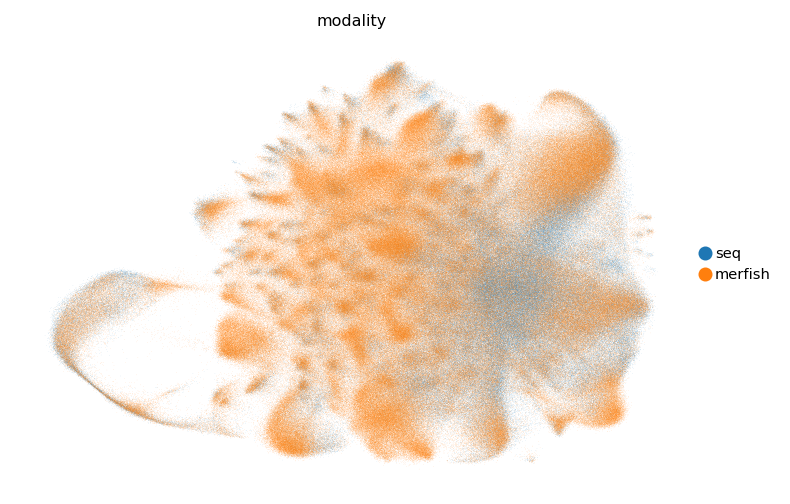

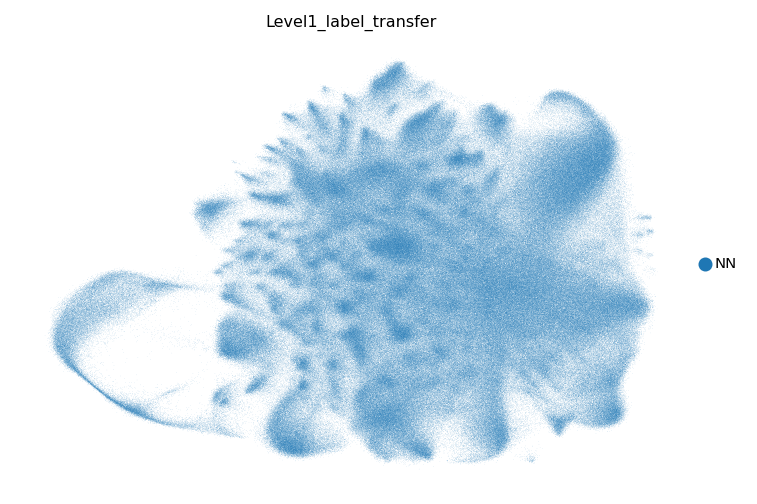

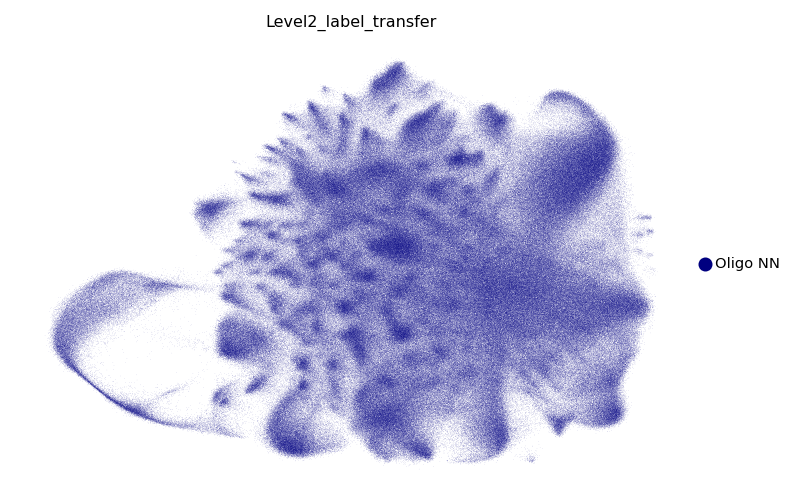

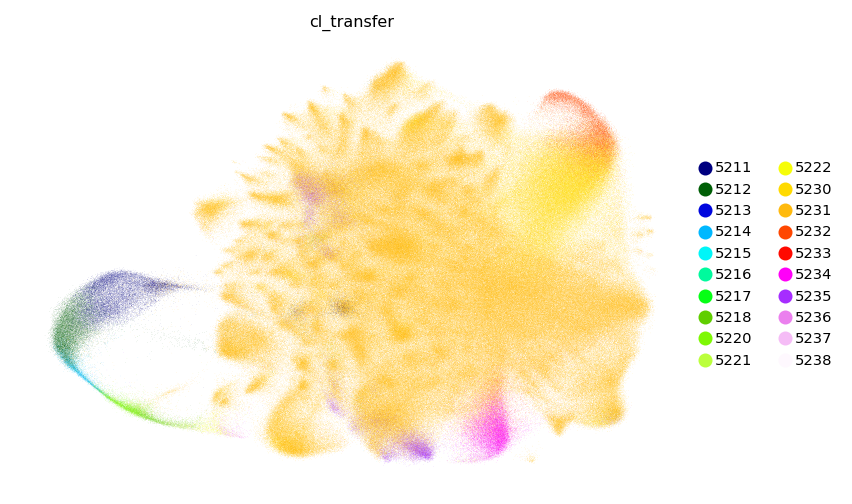

Integrate for p5
Use 1118 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 42898 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 3/3 Level1_label.
Transfered 6/6 Level2_label.
Transfered 129/129 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


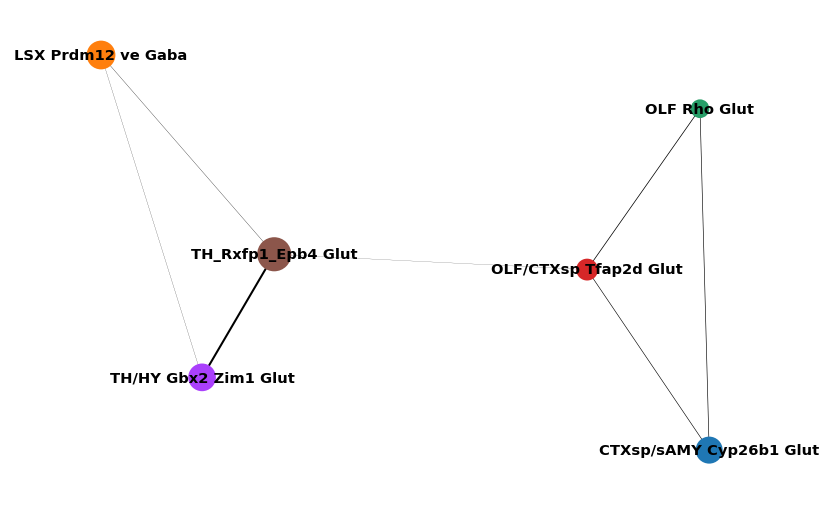

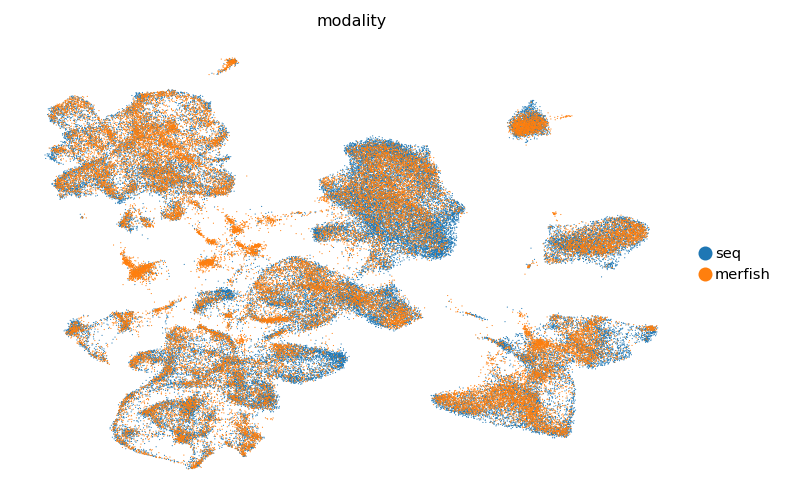

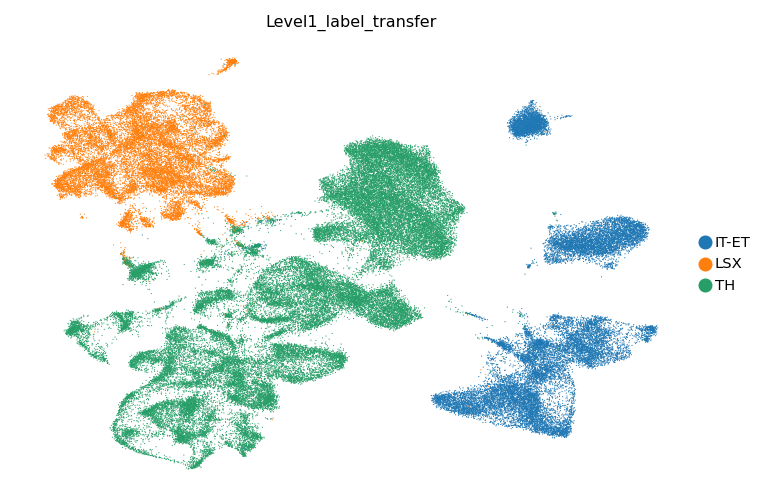

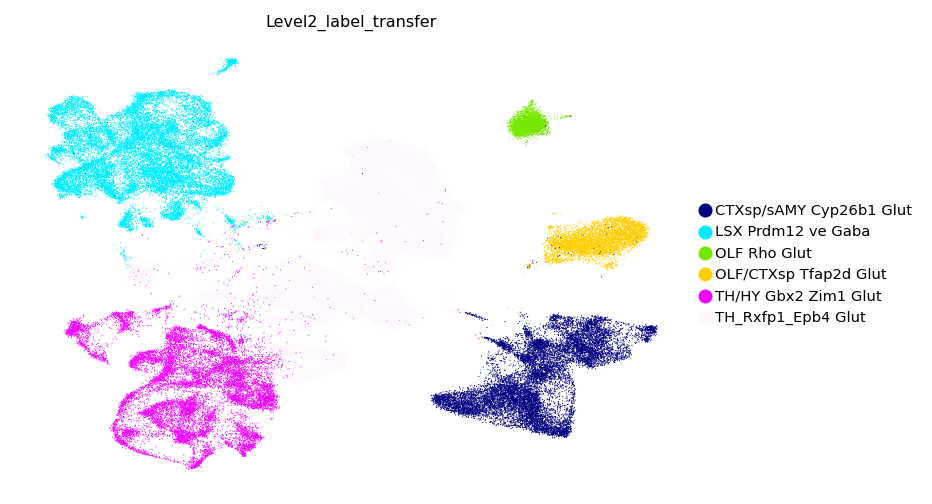

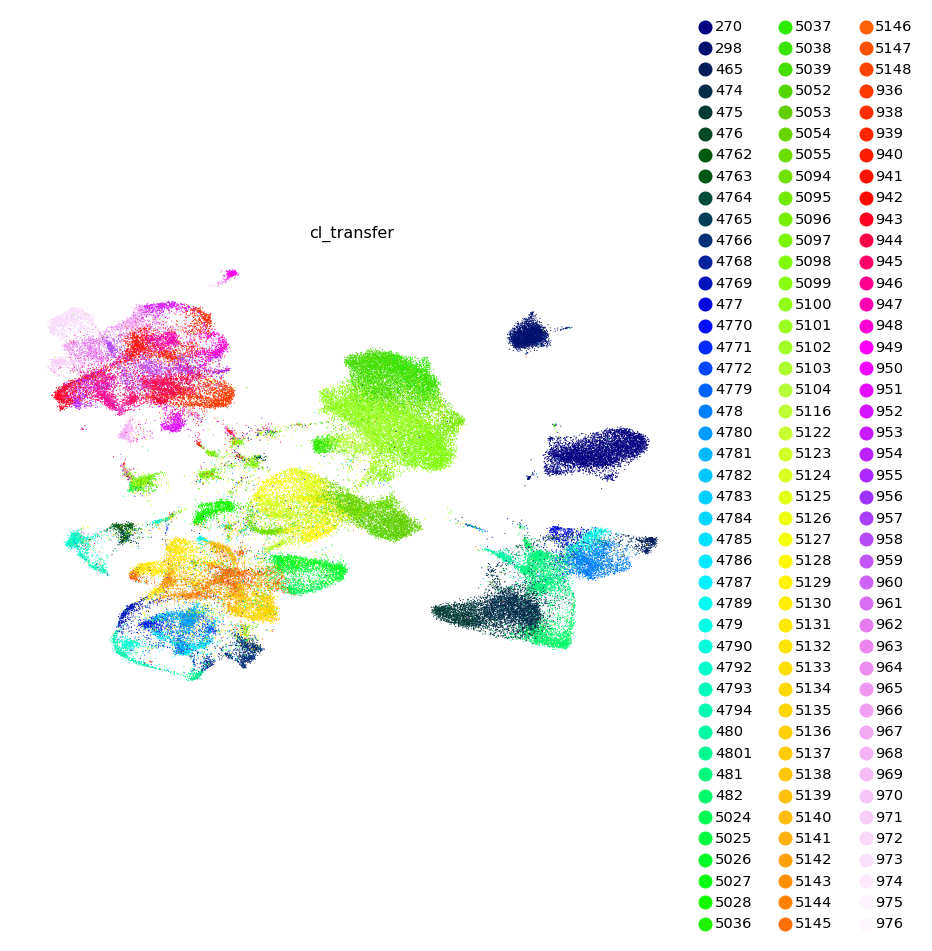

Integrate for p54
Use 1117 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 112710 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 18/18 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


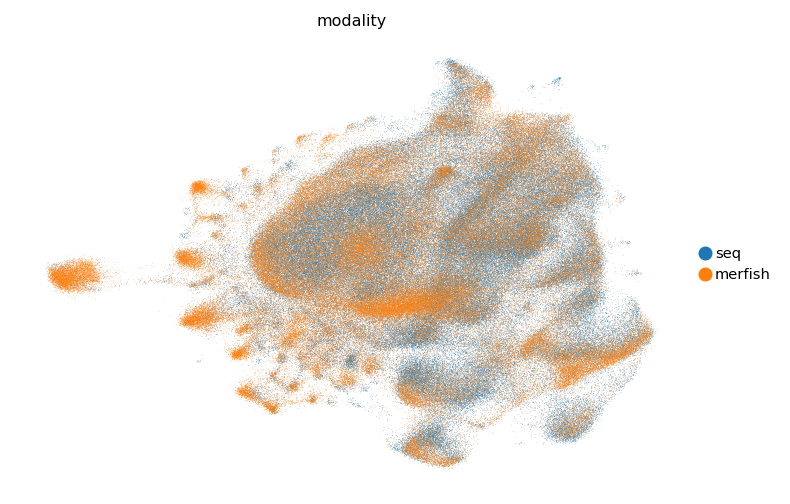

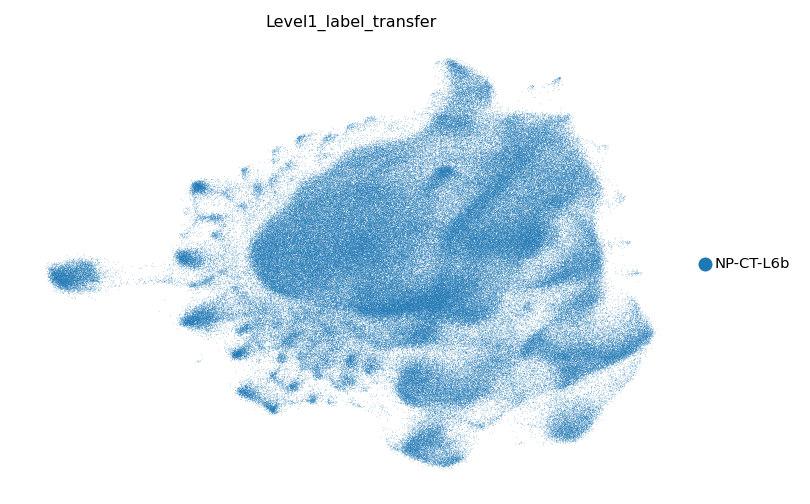

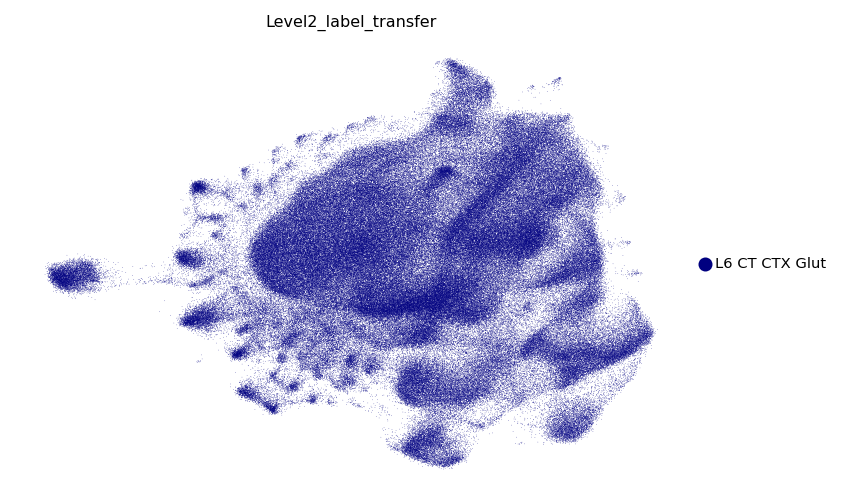

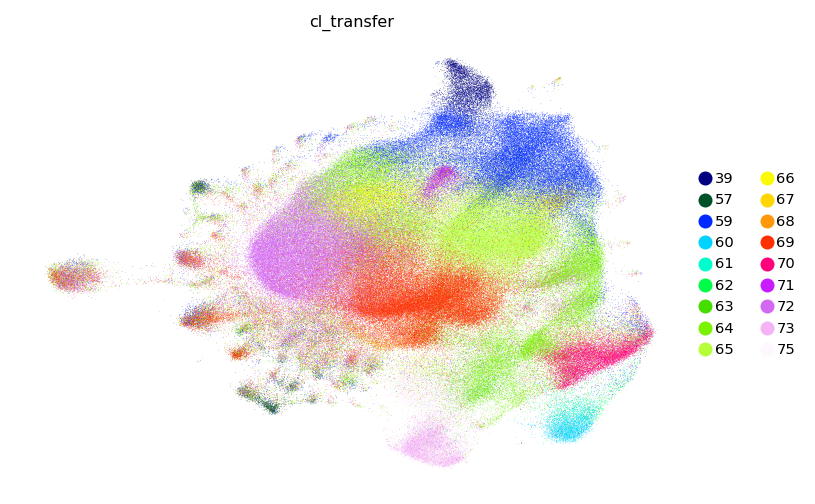

Integrate for p58
Use 1119 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 184970 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 41/41 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


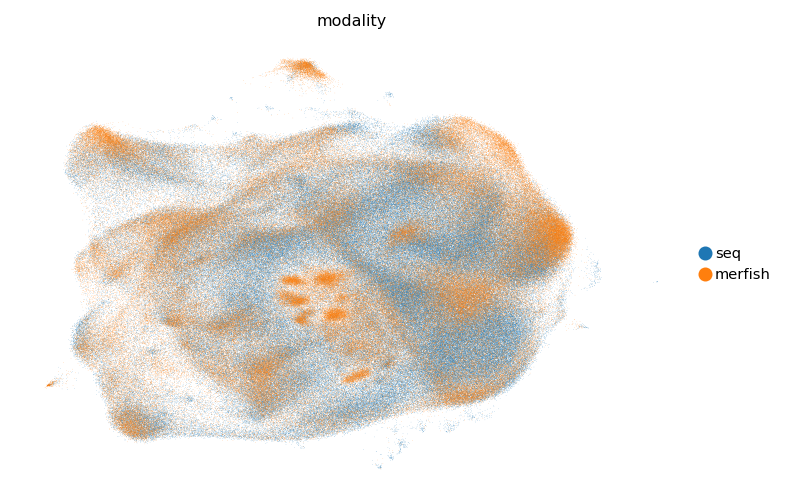

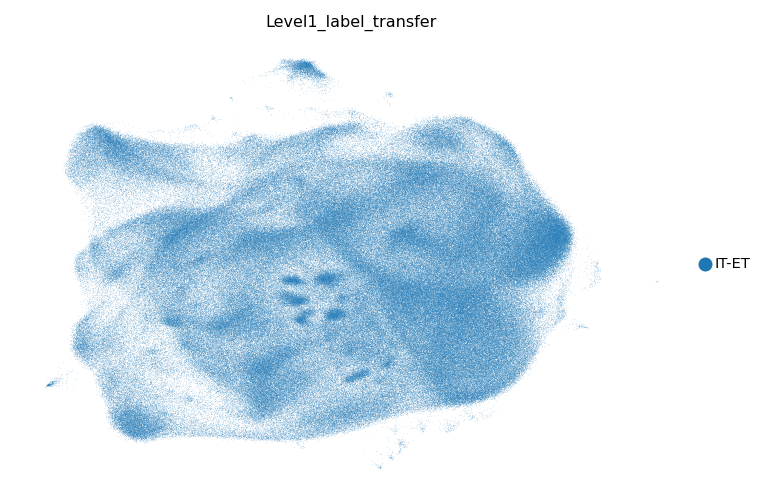

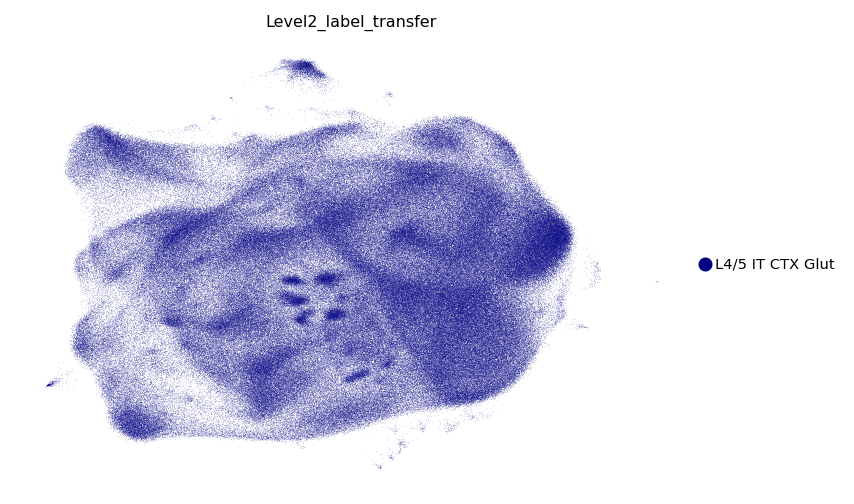

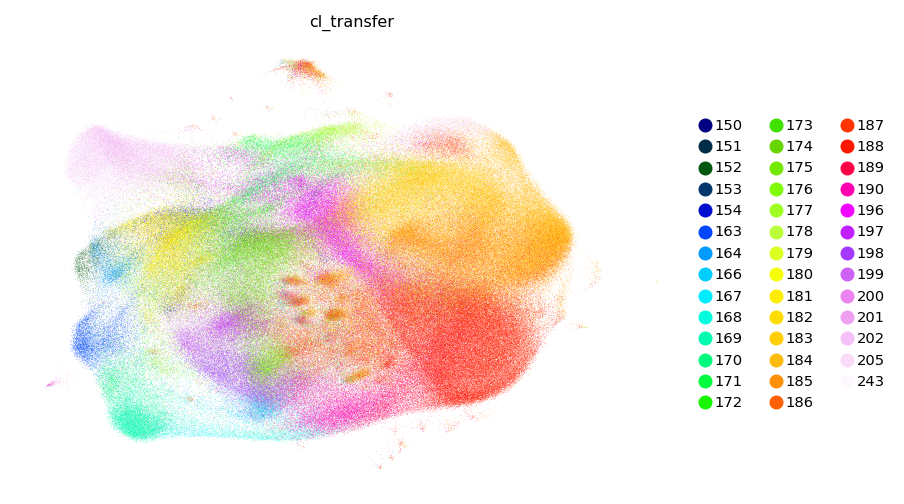

Integrate for p6
Use 1121 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 43375 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 5/5 Level1_label.
Transfered 5/5 Level2_label.
Transfered 166/166 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


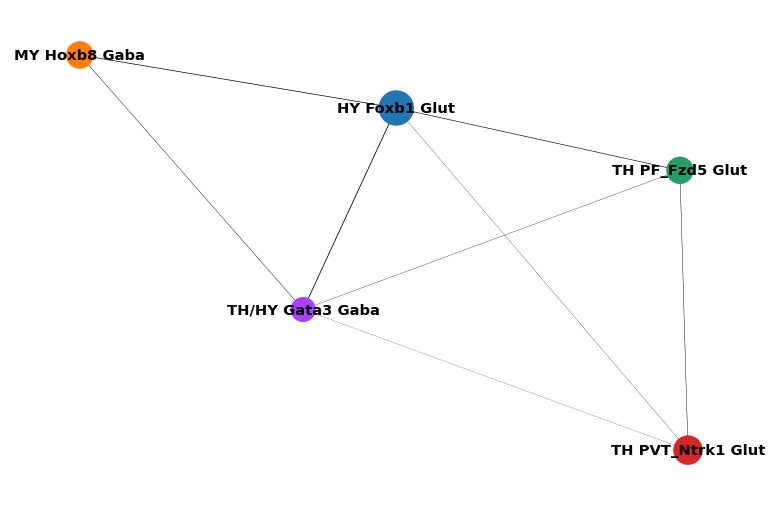

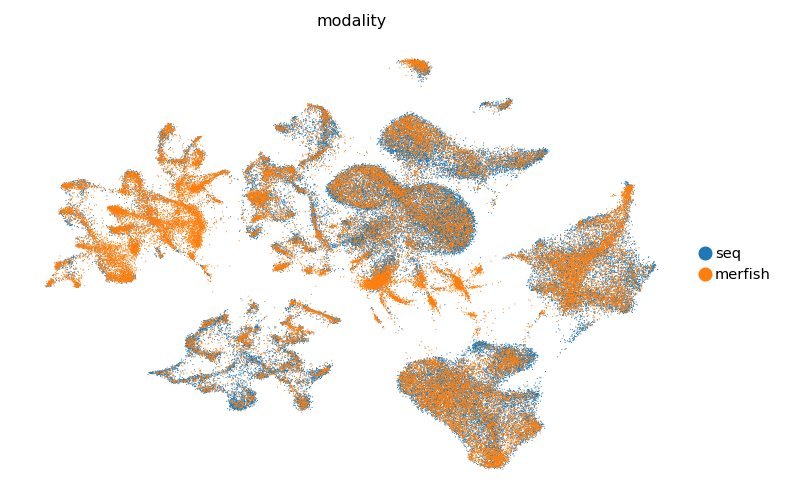

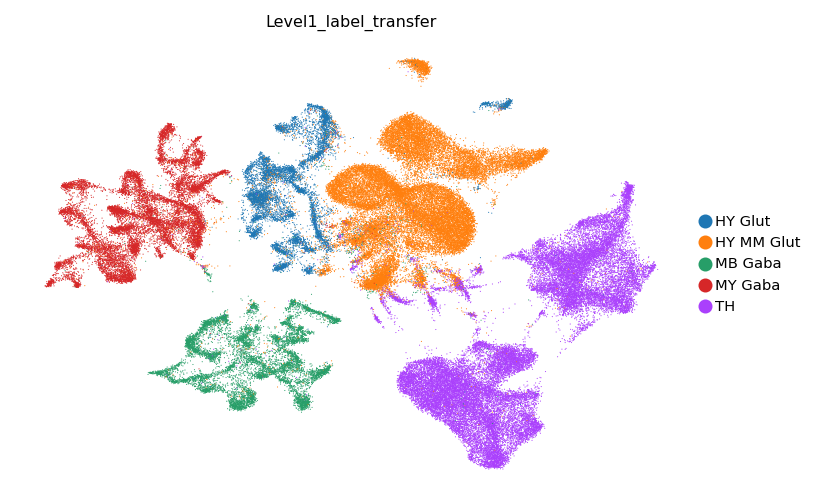

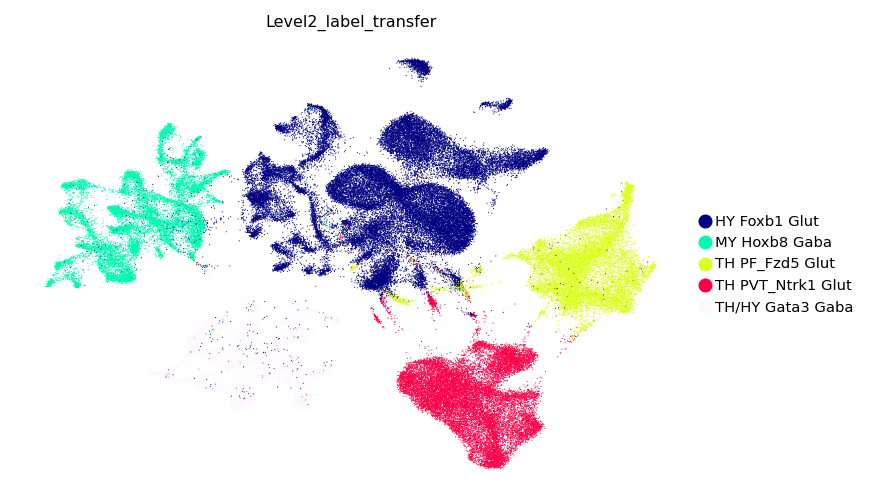

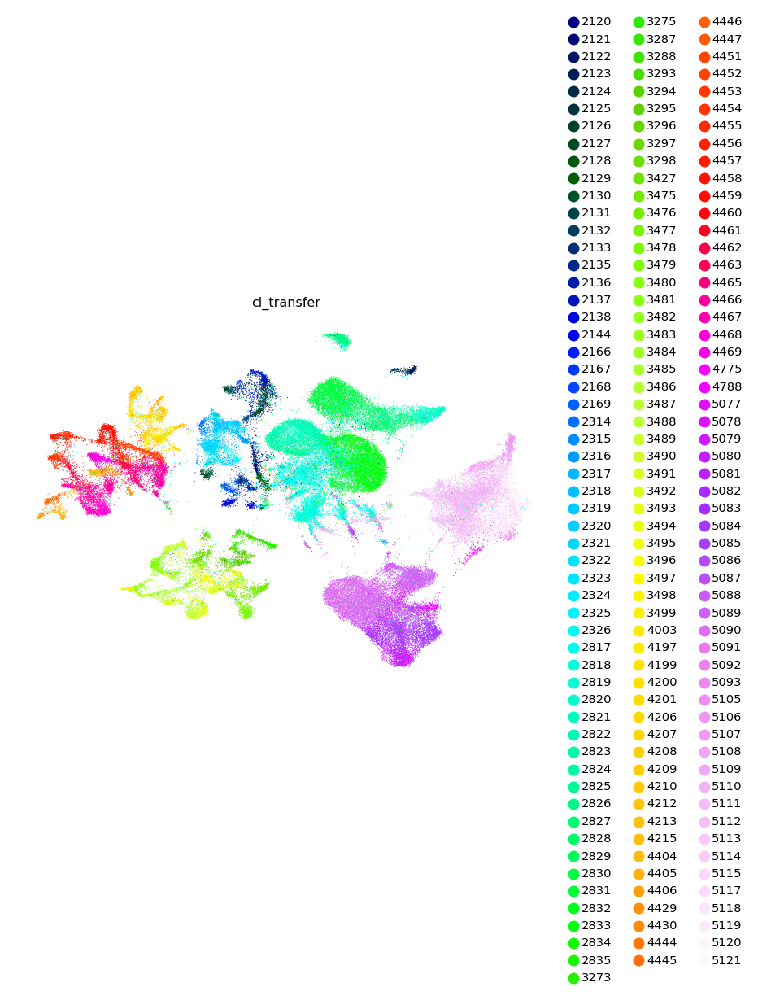

Integrate for p64
Use 1118 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 162730 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 19/19 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


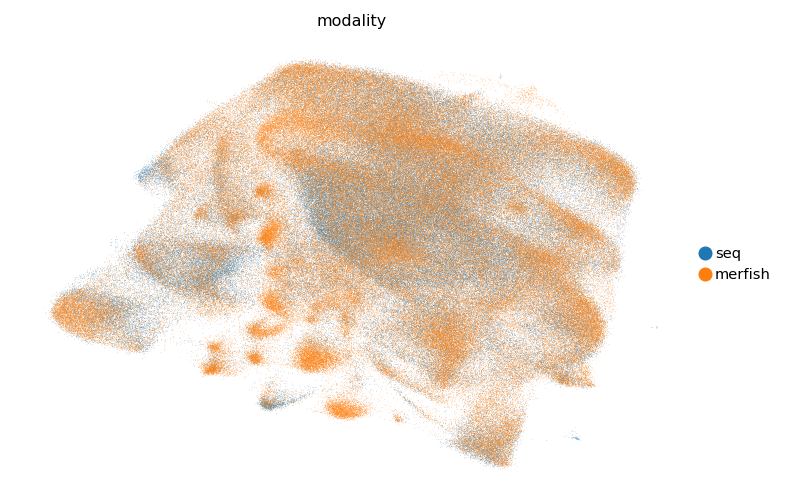

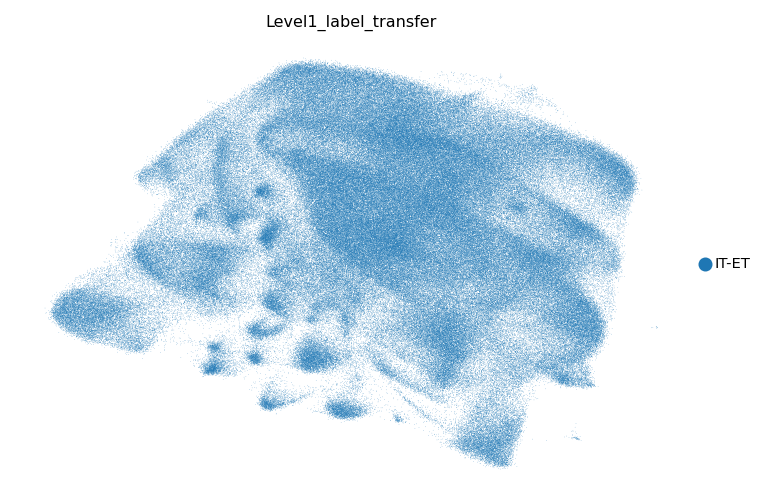

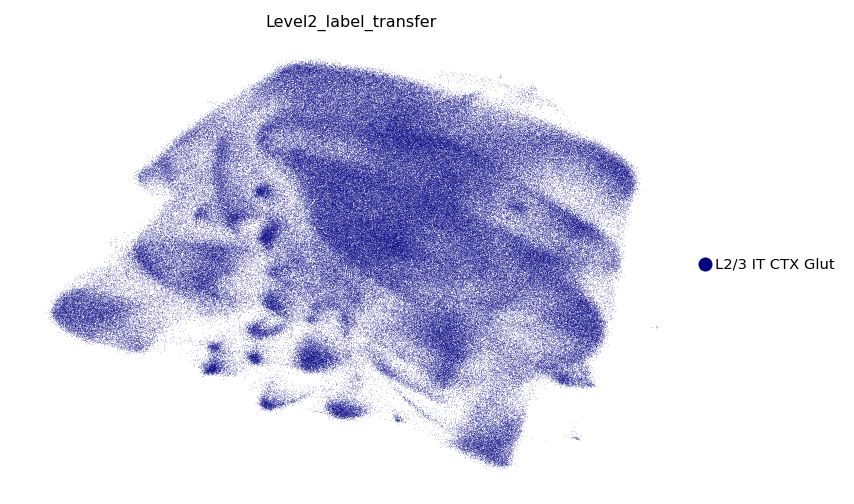

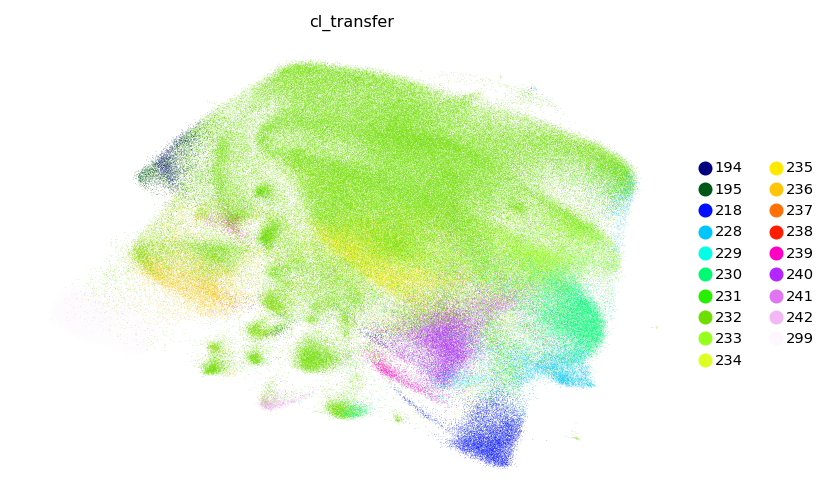

Integrate for p66
Use 1116 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 74445 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 24/24 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


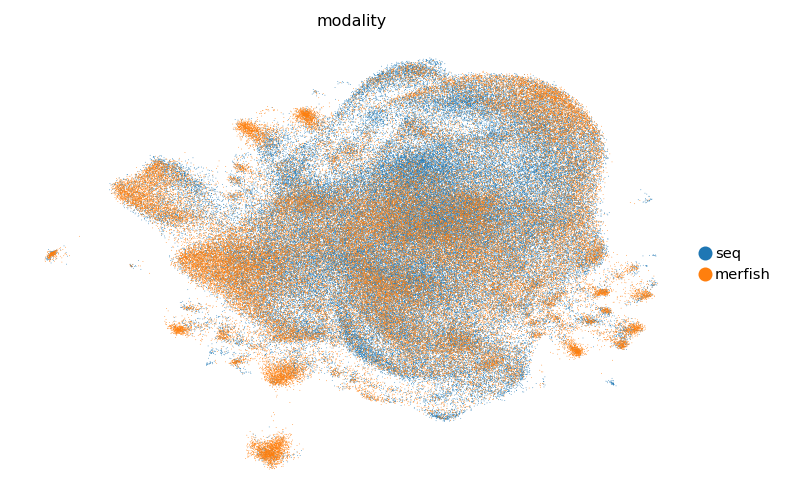

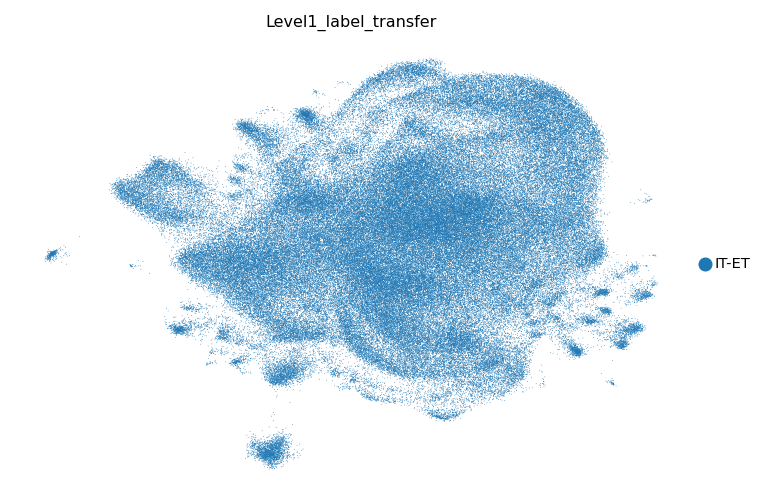

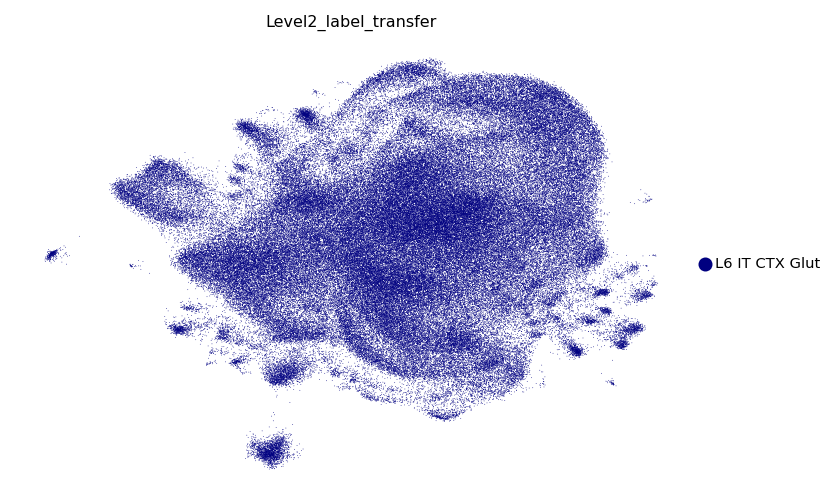

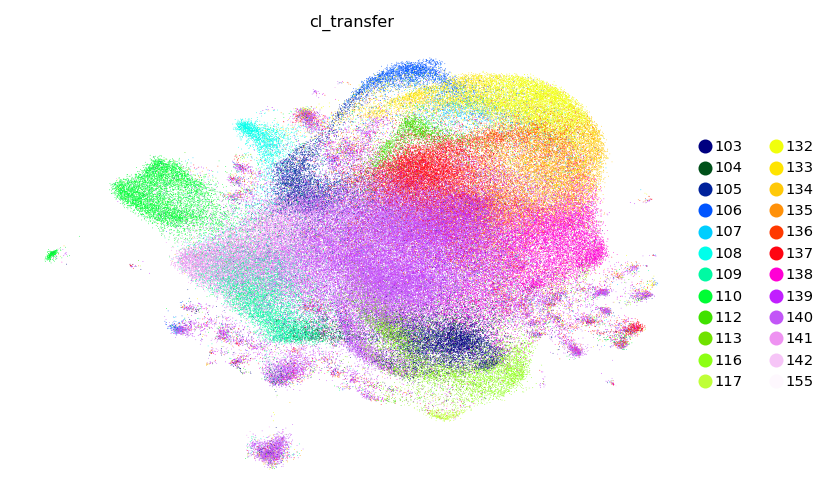

Integrate for p67
Use 1107 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 39964 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 11/11 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


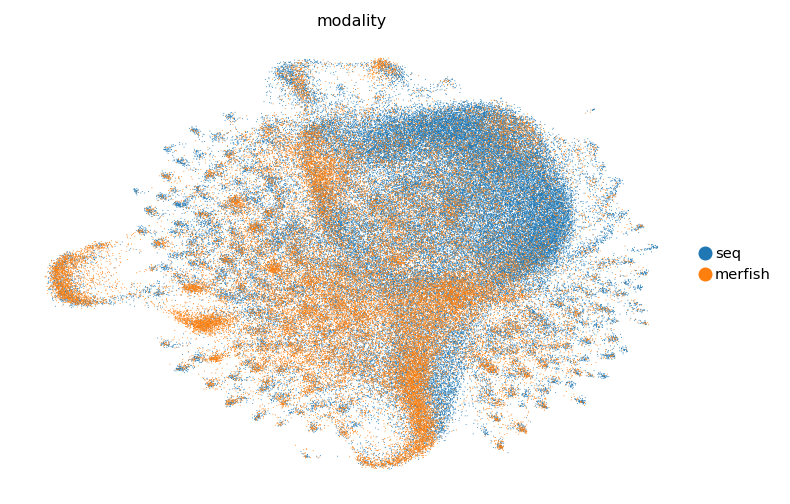

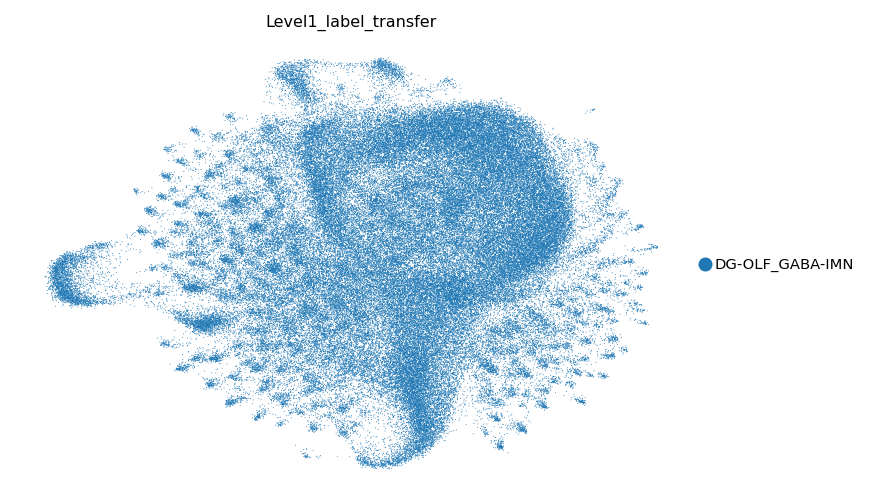

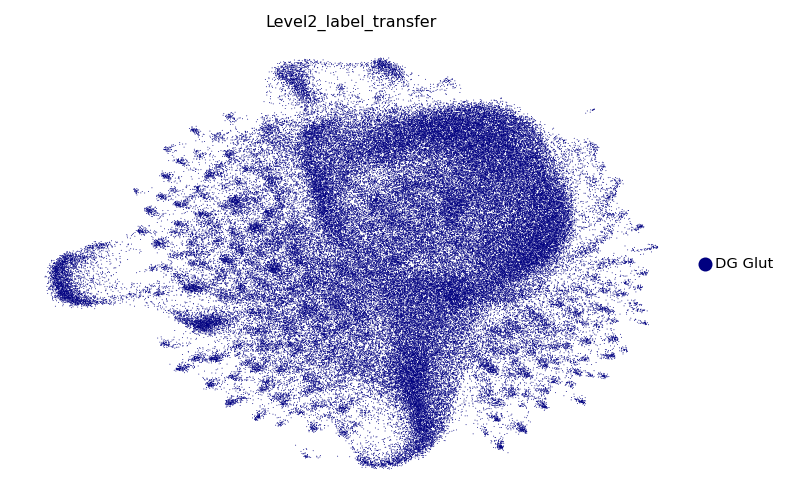

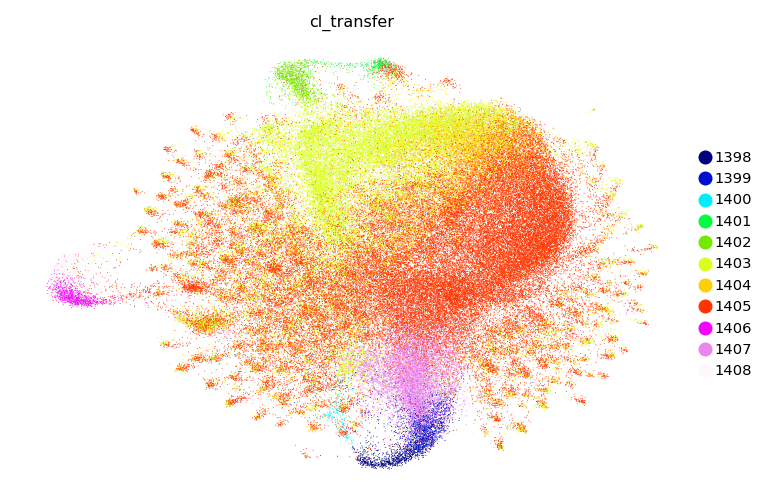

Integrate for p69
Use 1122 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 84864 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 5/5 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


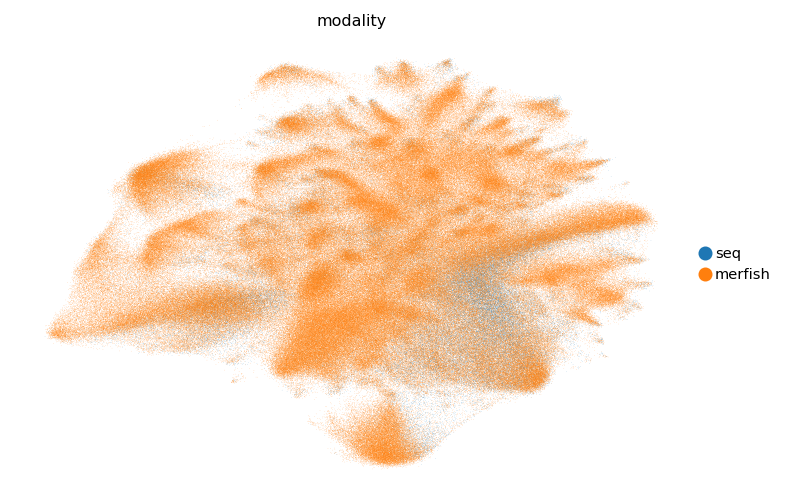

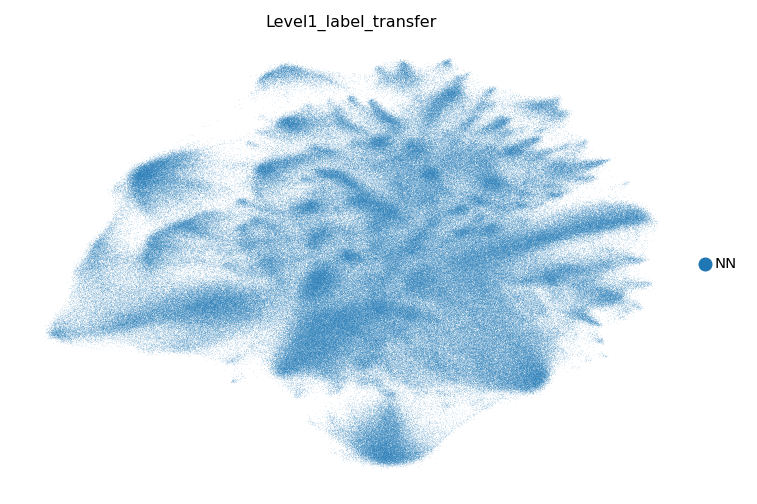

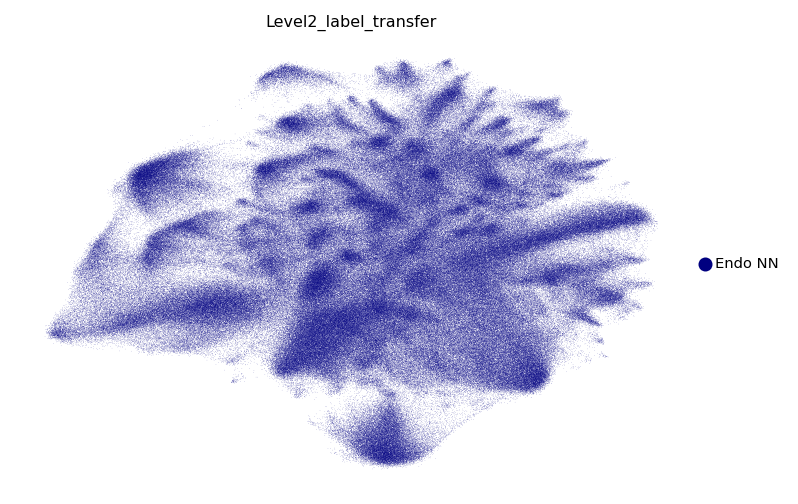

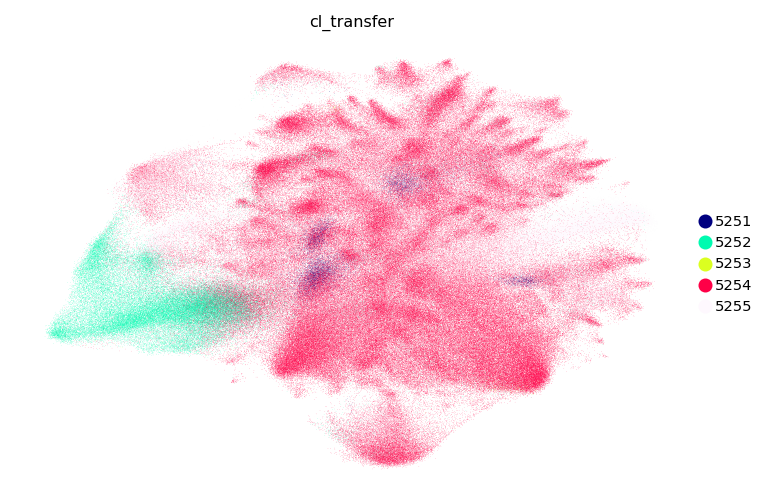

Integrate for p7
Use 1118 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 64340 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 3/3 Level1_label.
Transfered 4/4 Level2_label.
Transfered 262/262 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


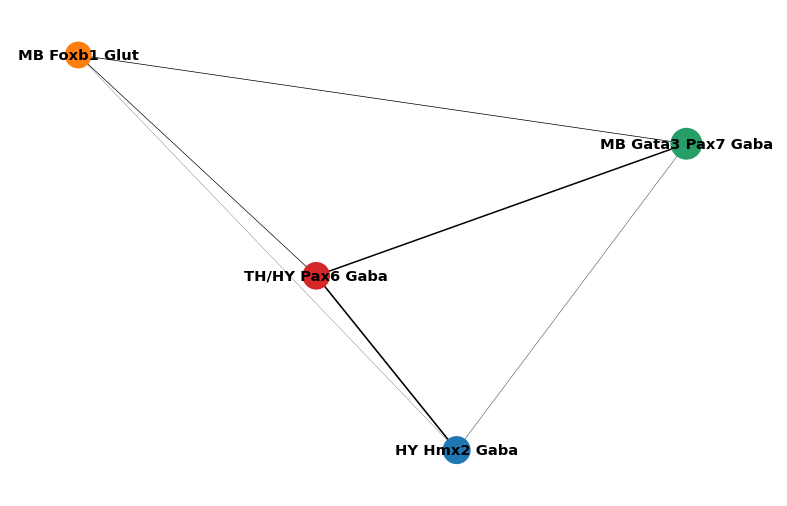

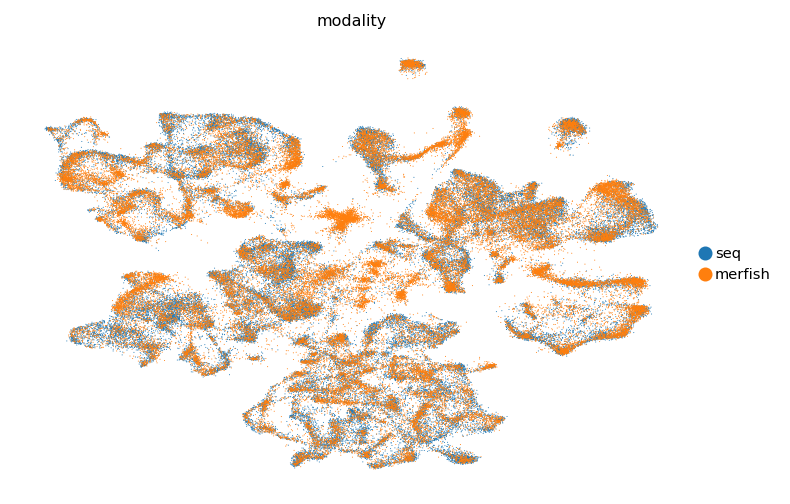

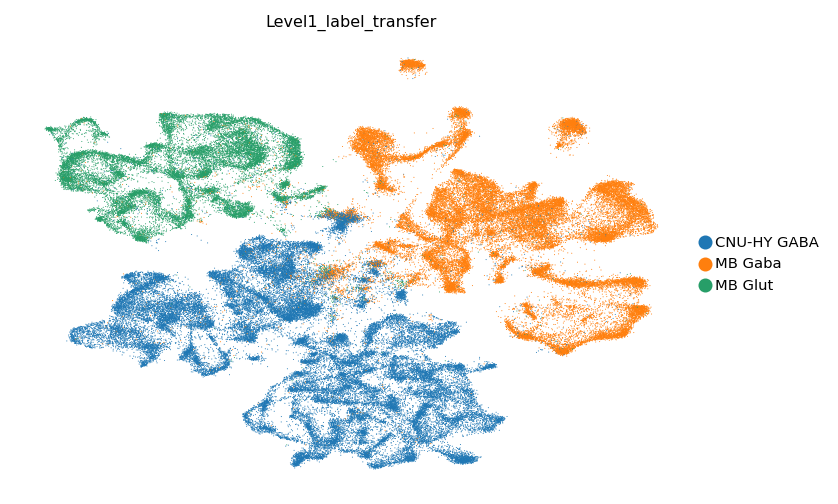

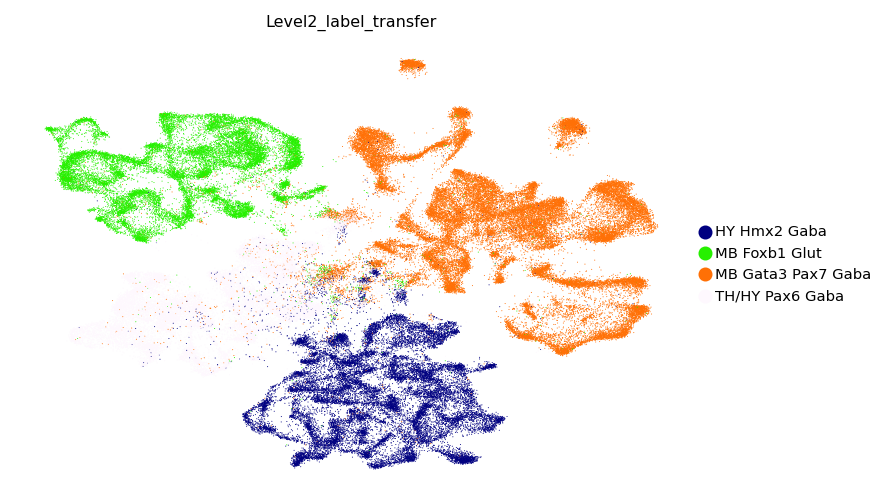

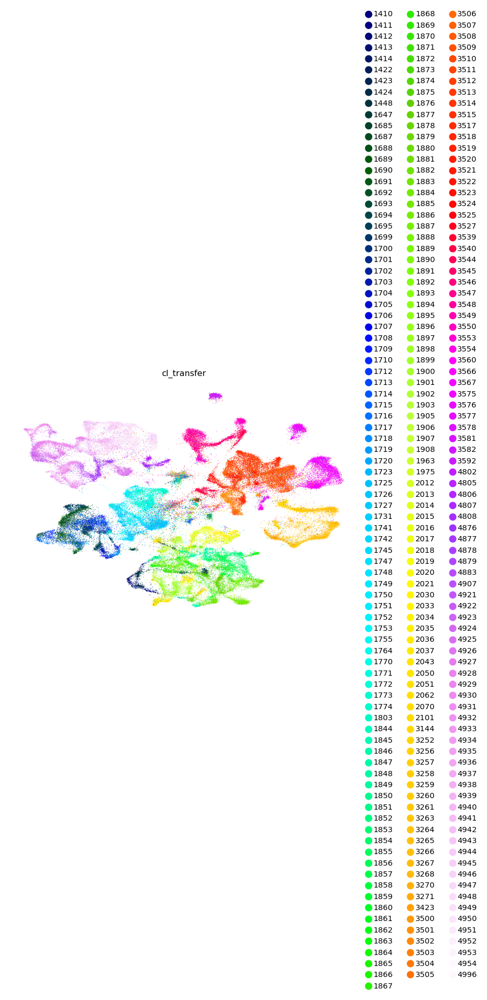

Integrate for p70
Use 1110 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 72418 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 2/2 Level1_label.
Transfered 3/3 Level2_label.
Transfered 36/36 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


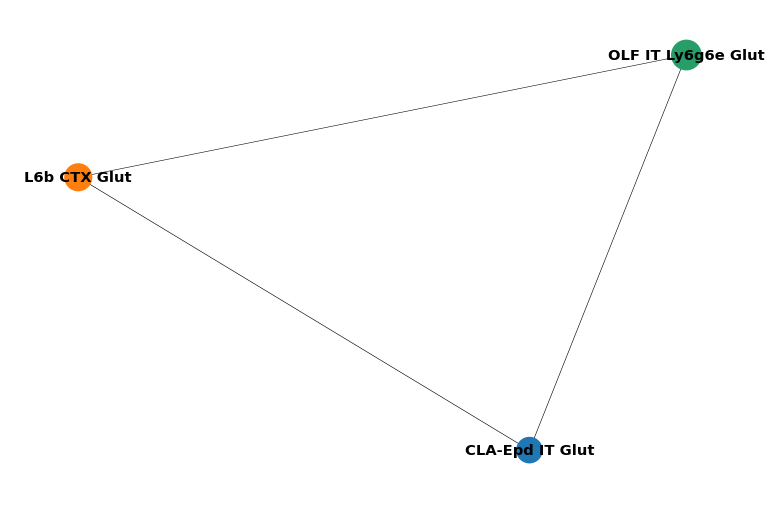

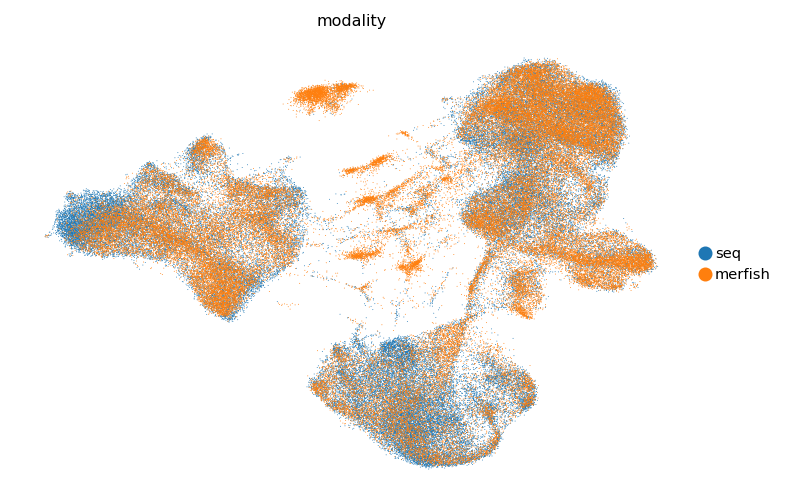

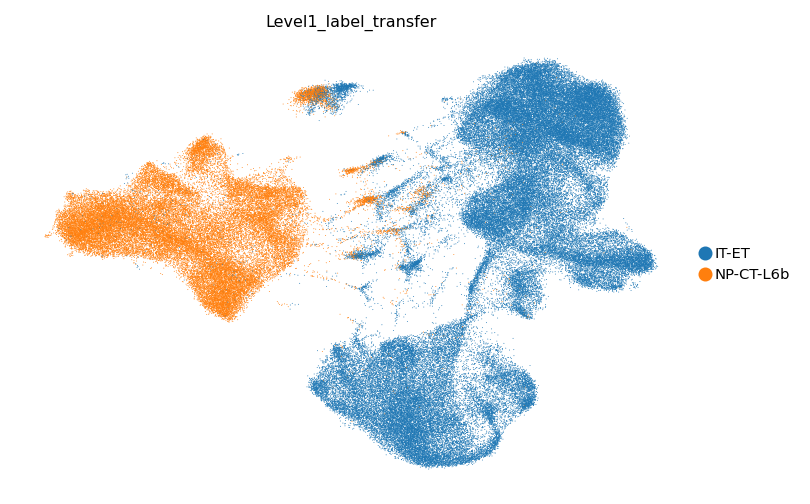

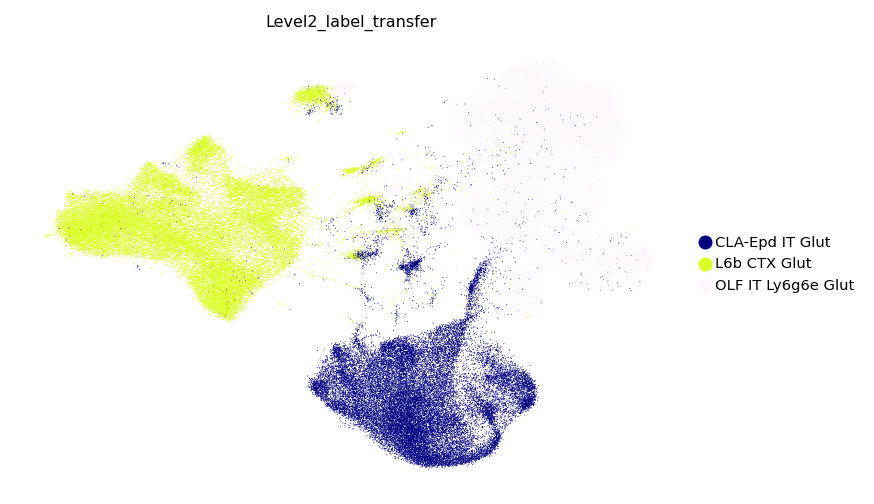

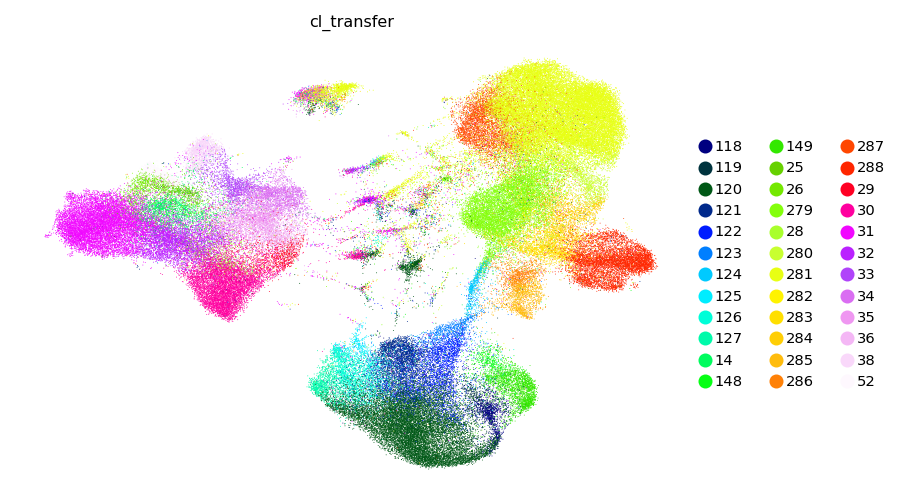

Integrate for p71
Use 1109 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 59176 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 2/2 Level1_label.
Transfered 2/2 Level2_label.
Transfered 14/14 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


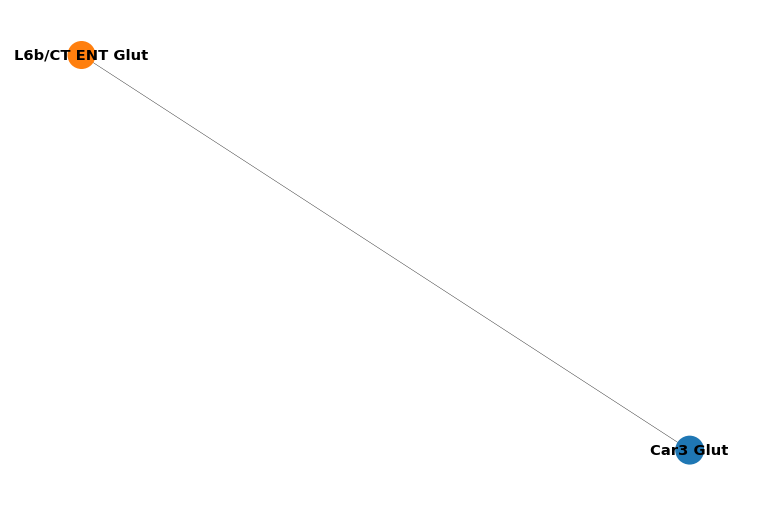

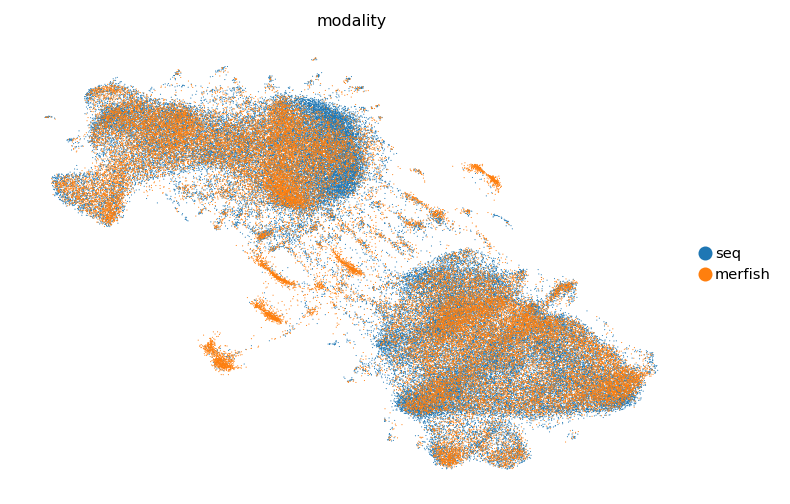

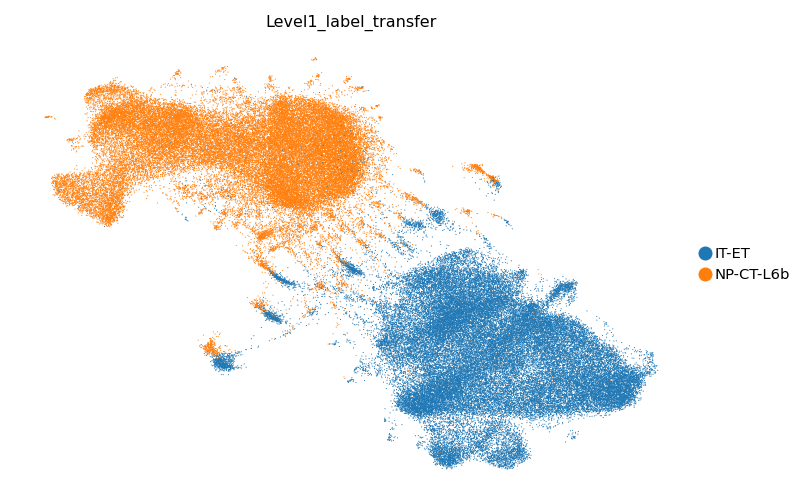

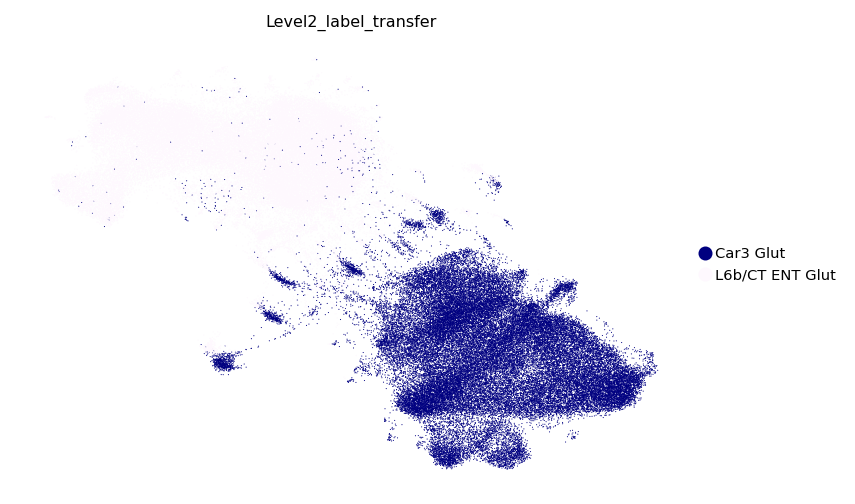

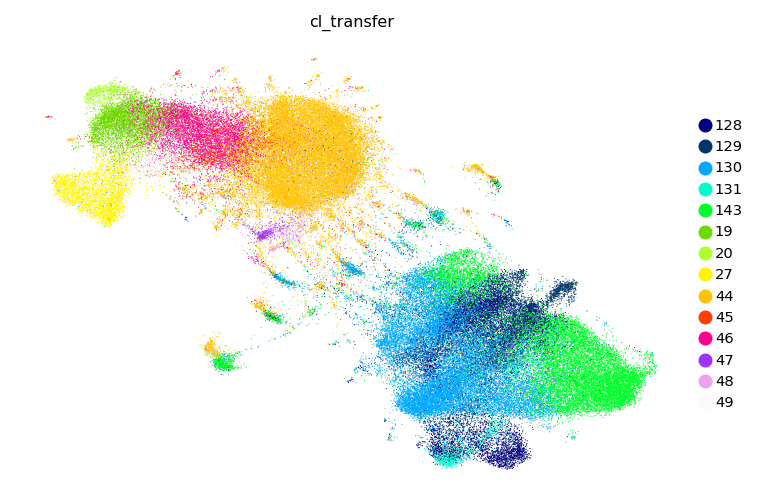

Integrate for p72
Use 1108 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 73735 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 3/3 Level2_label.
Transfered 59/59 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


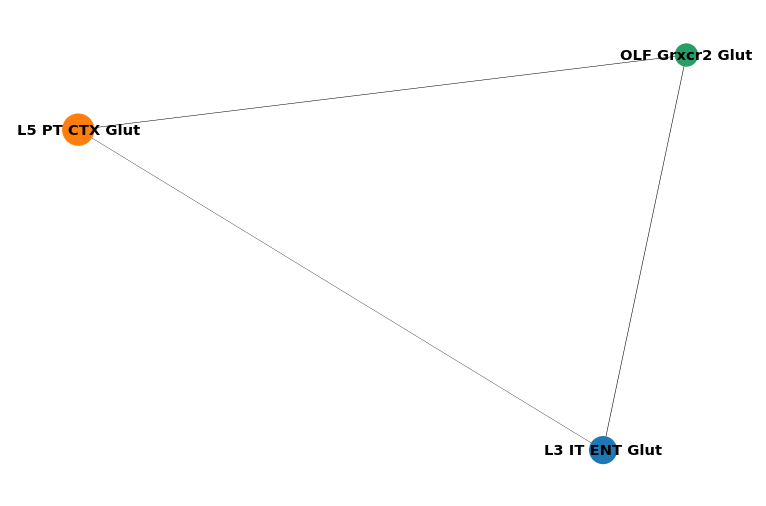

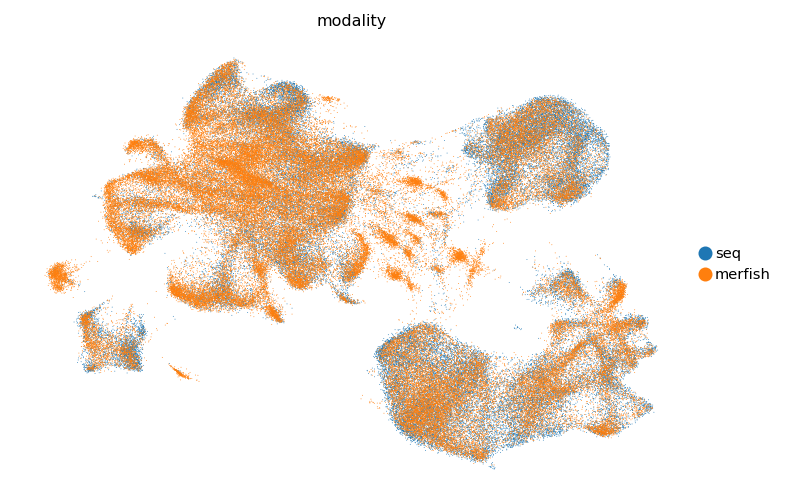

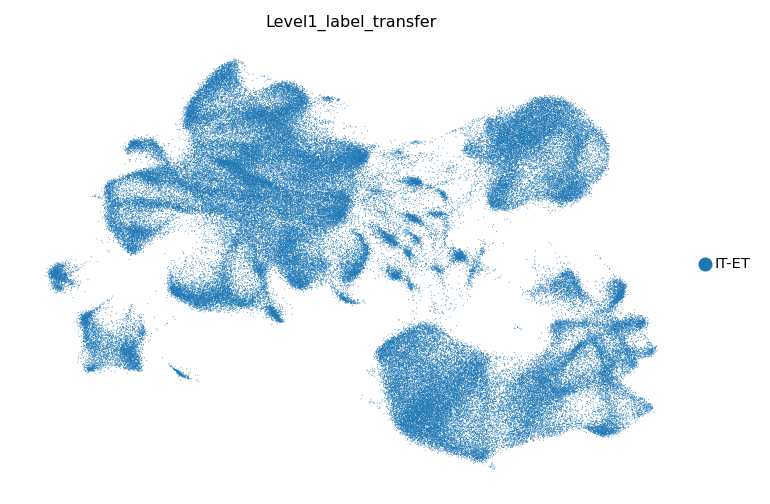

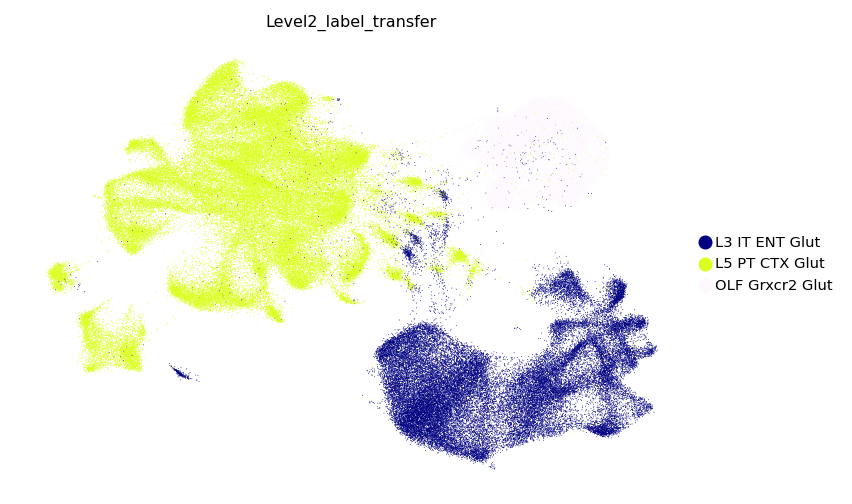

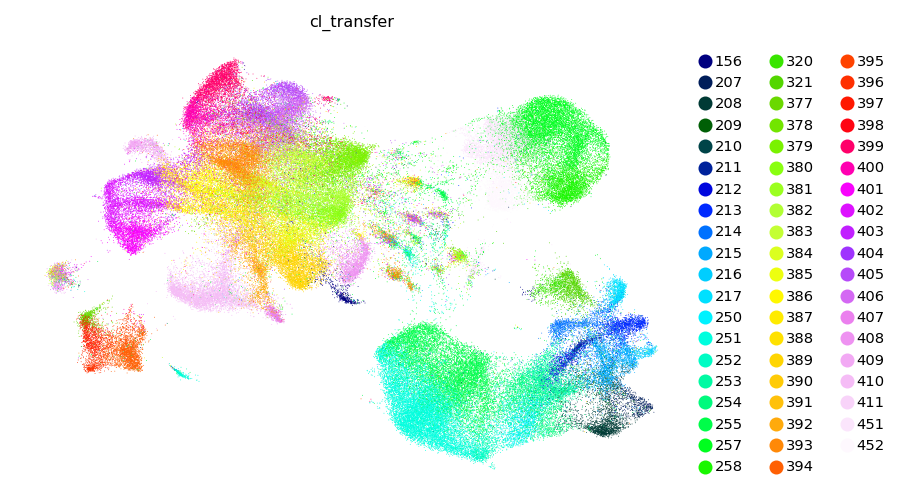

Integrate for p73
Use 1108 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 64258 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 3/3 Level2_label.
Transfered 70/70 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


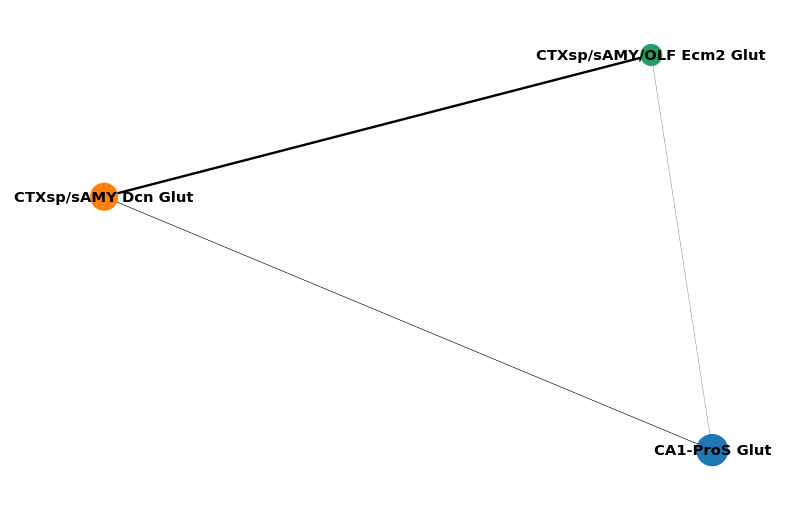

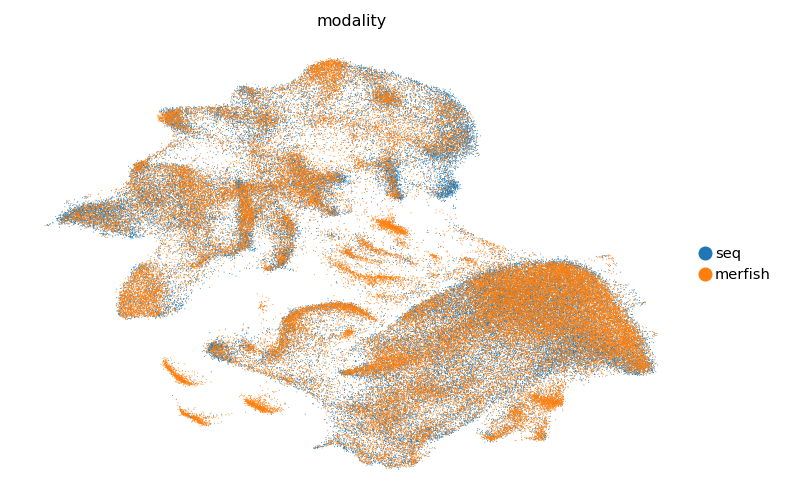

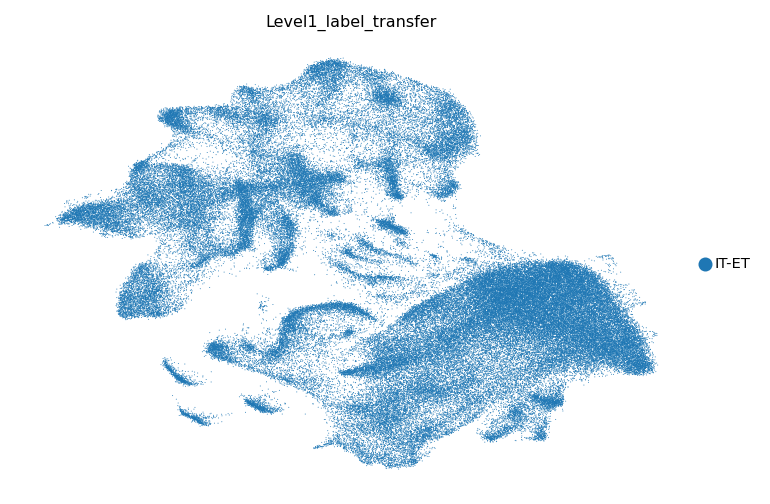

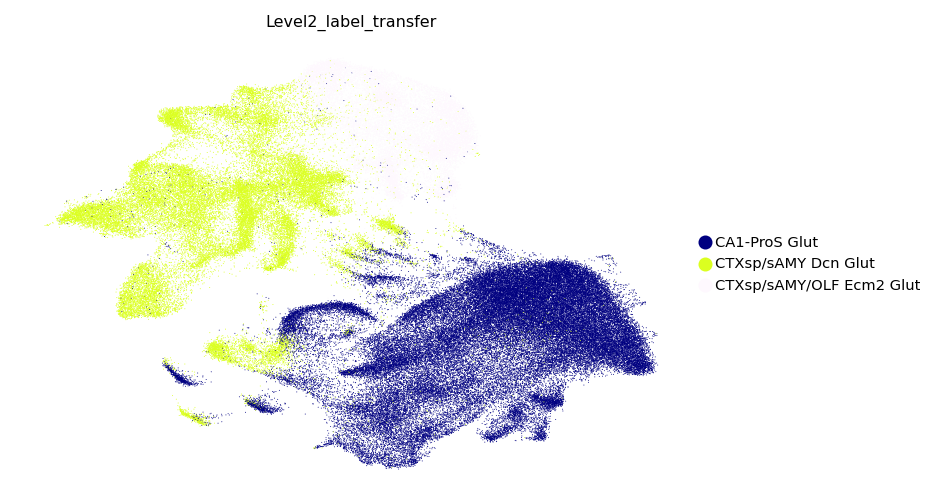

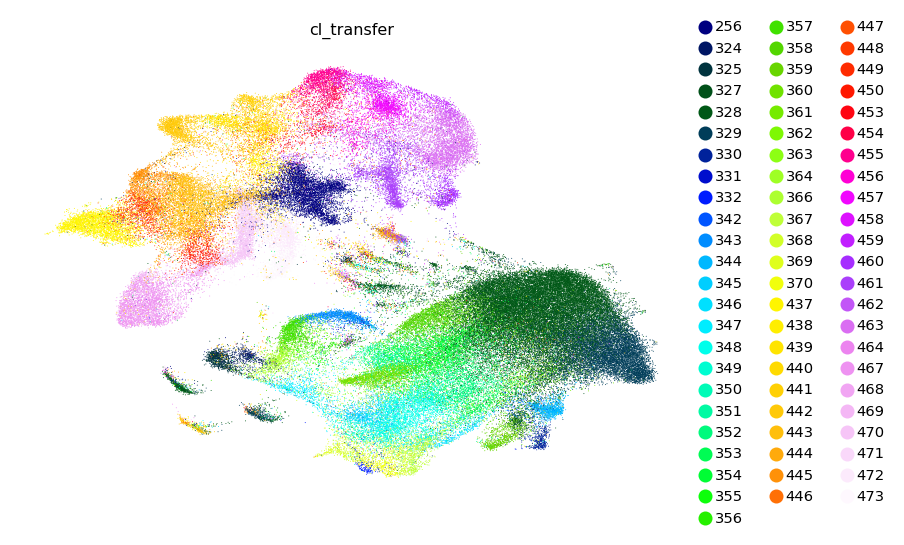

Integrate for p74
Use 1108 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 50596 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 2/2 Level1_label.
Transfered 12/12 Level2_label.
Transfered 70/70 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


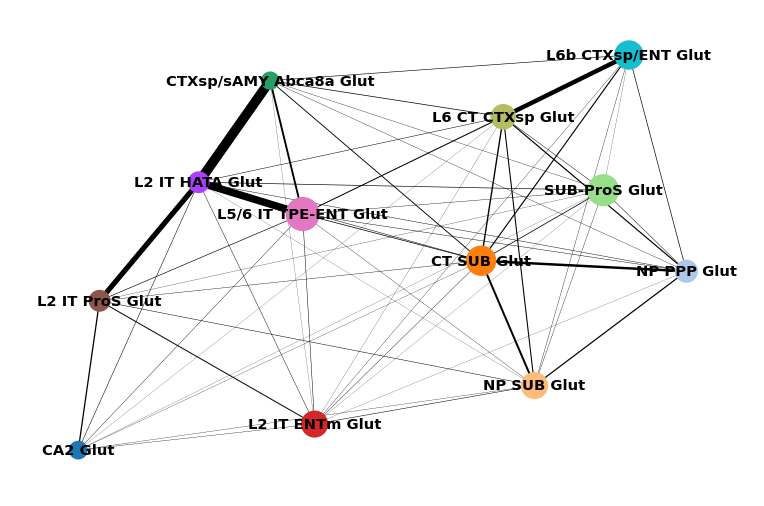

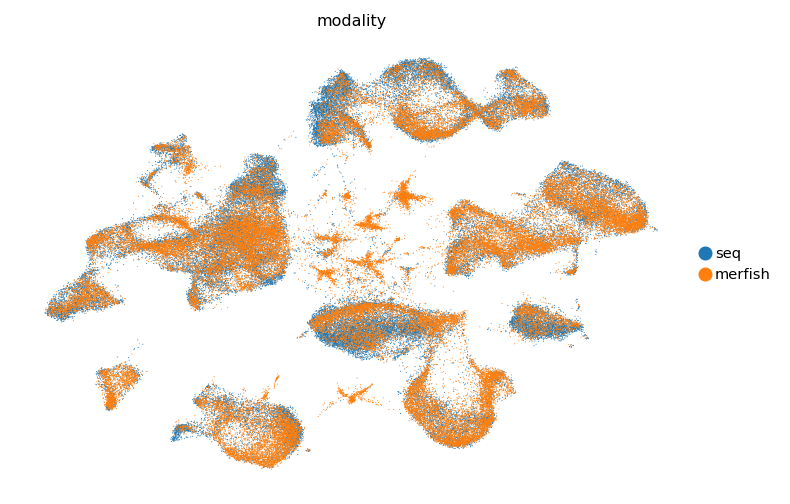

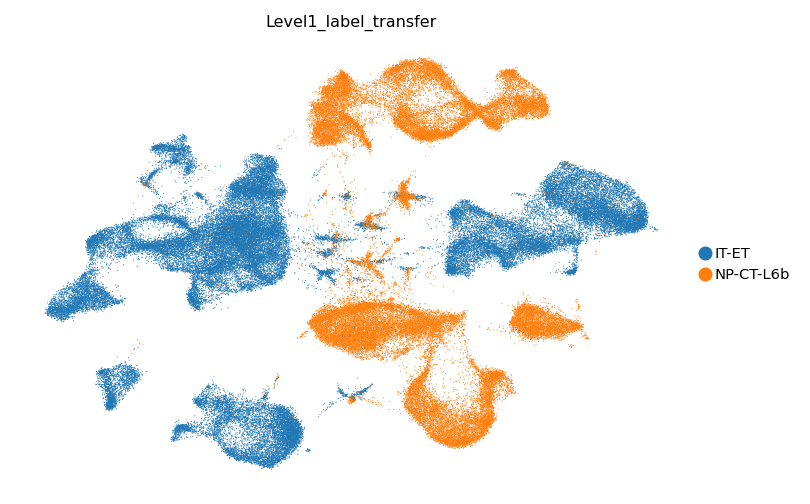

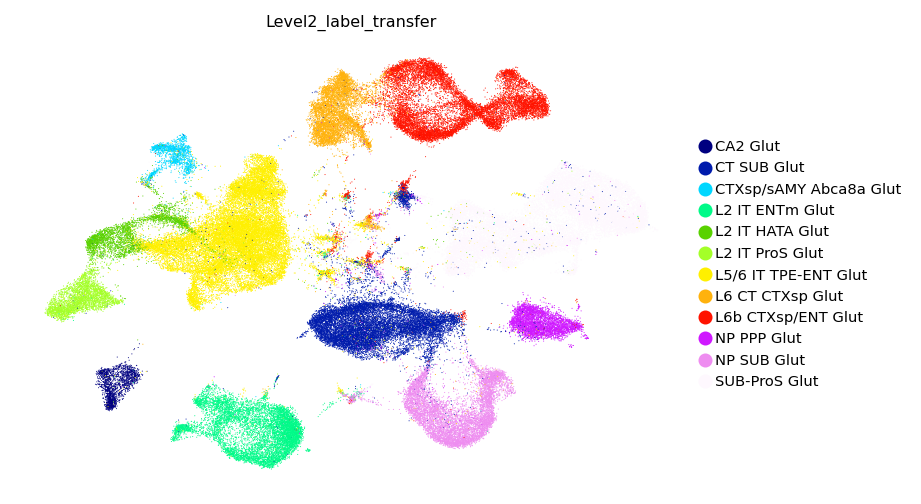

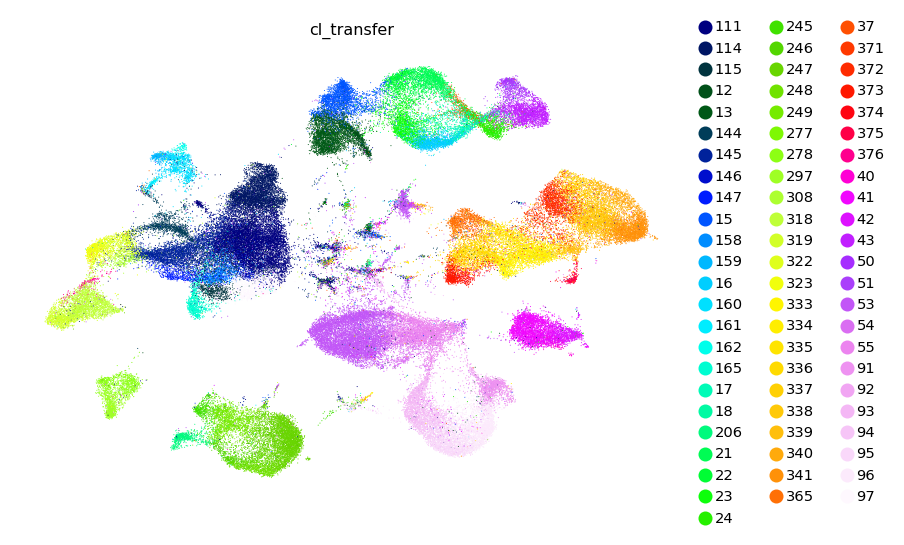

Integrate for p75
Use 1100 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 69535 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 2/2 Level1_label.
Transfered 4/4 Level2_label.
Transfered 71/71 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


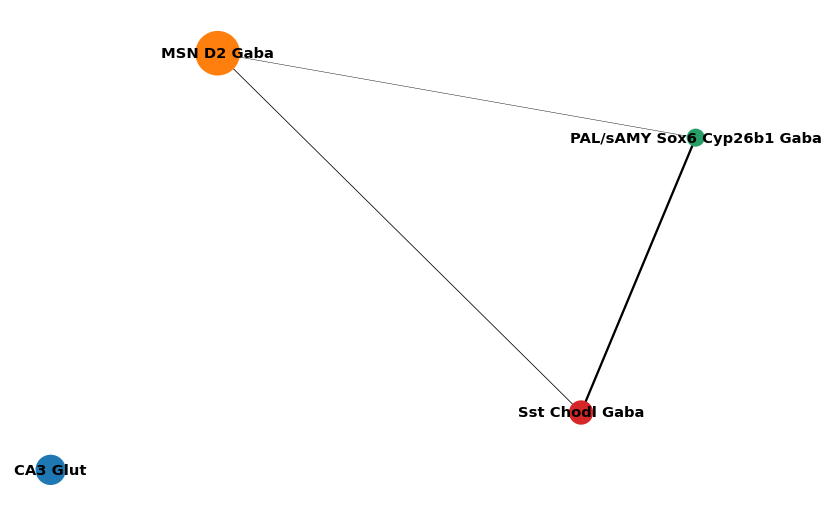

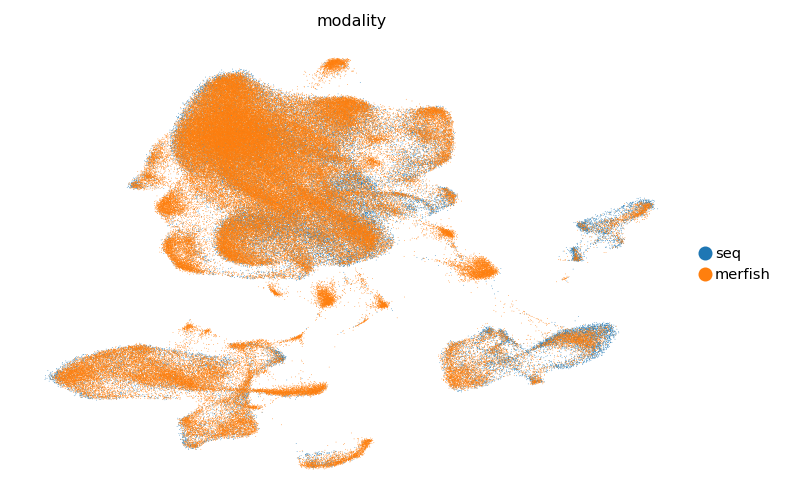

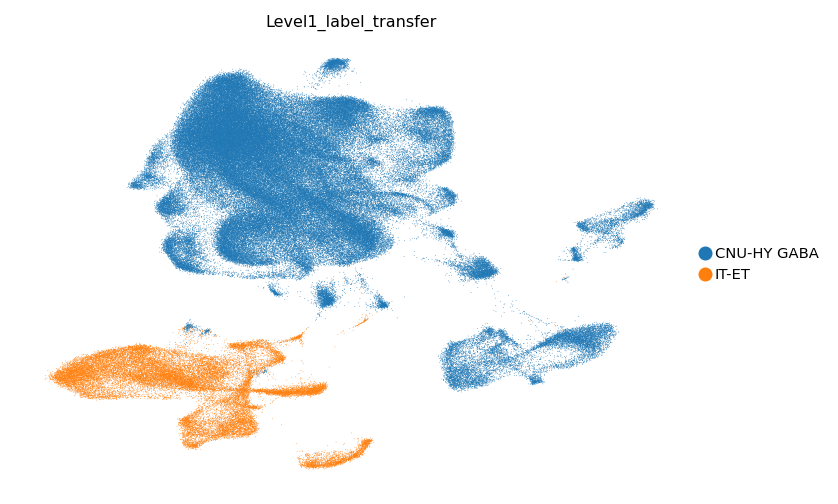

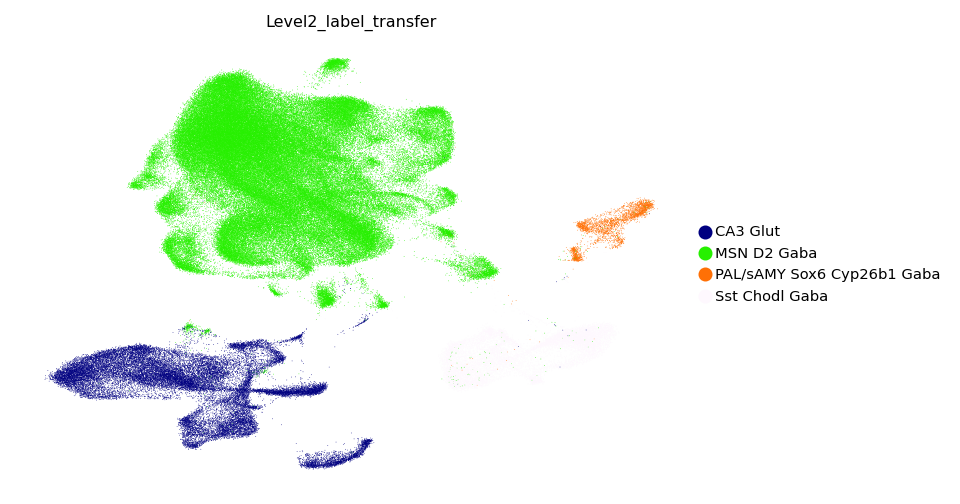

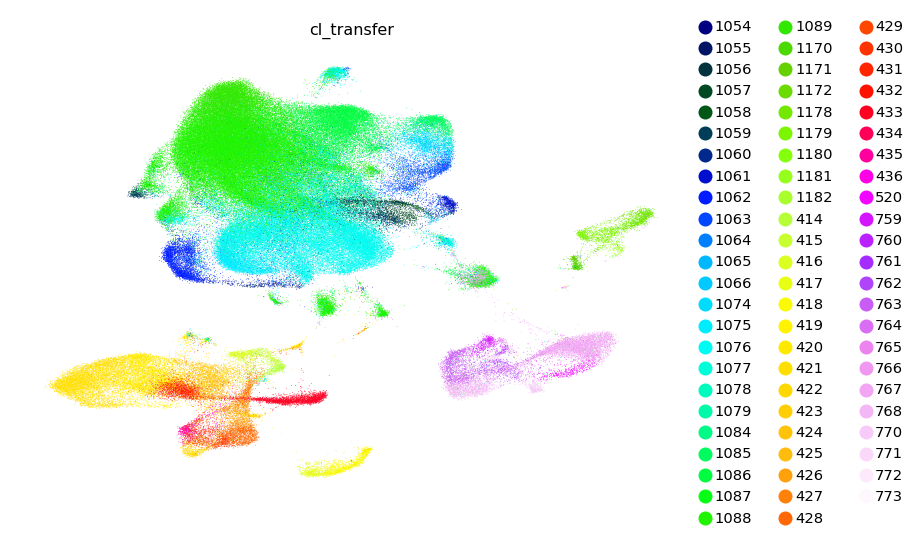

Integrate for p76
Use 1103 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 55471 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 28/28 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


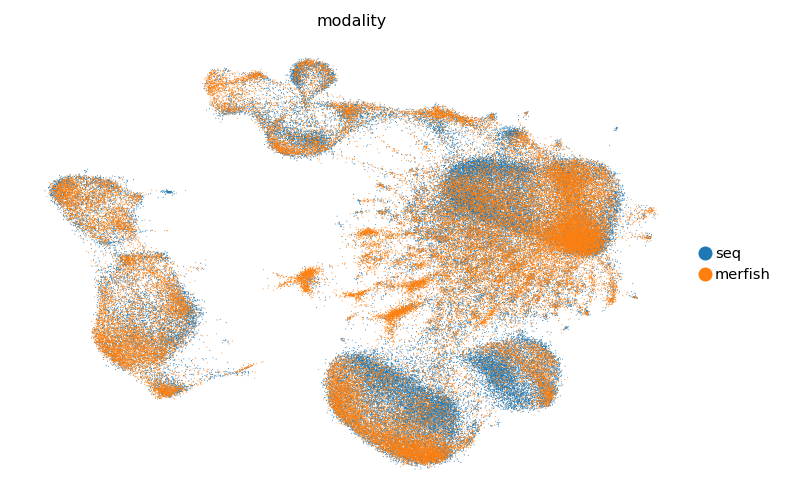

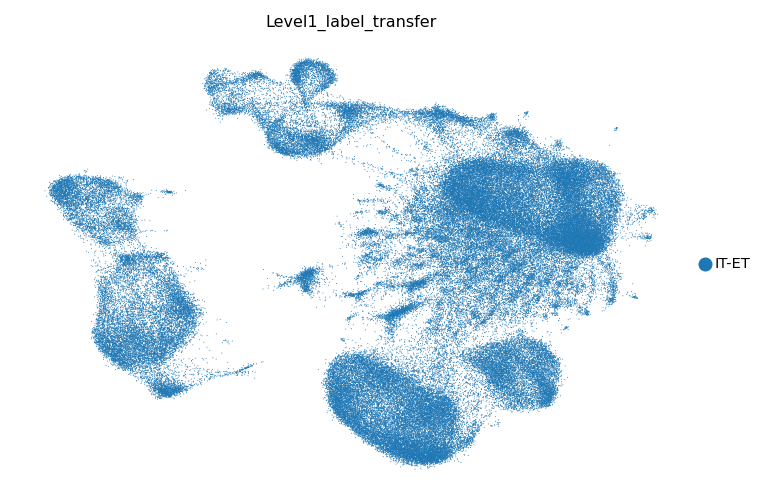

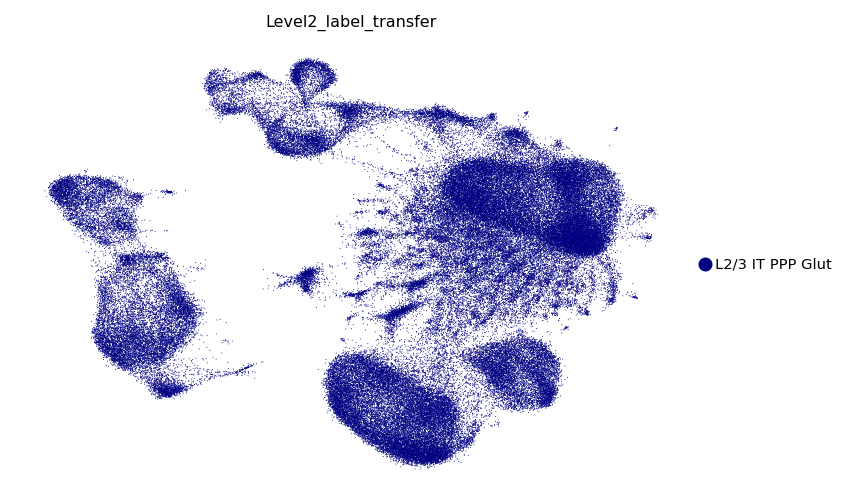

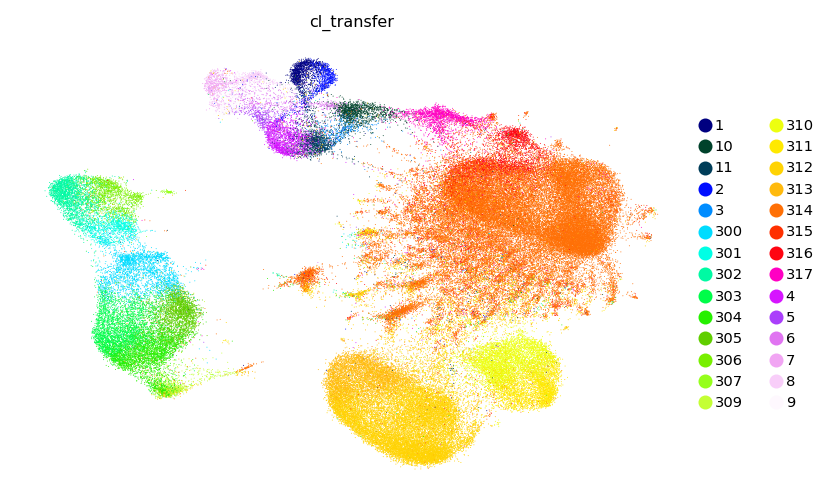

Integrate for p77
Use 1112 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 98909 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 2/2 Level1_label.
Transfered 2/2 Level2_label.
Transfered 35/35 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


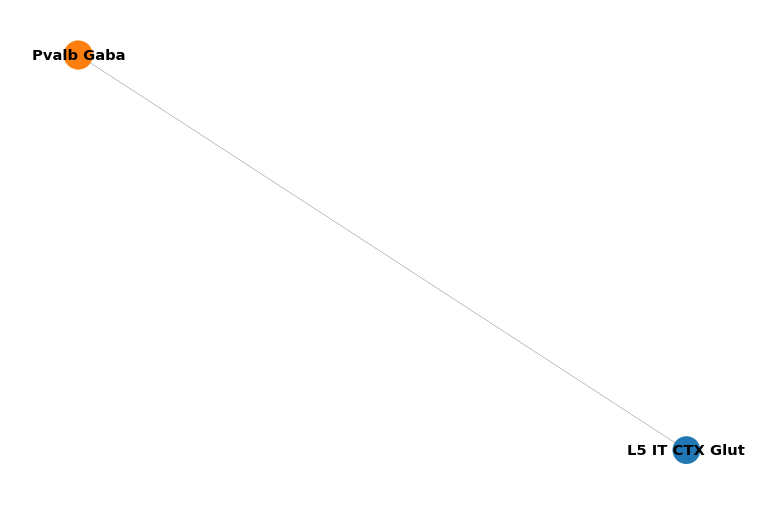

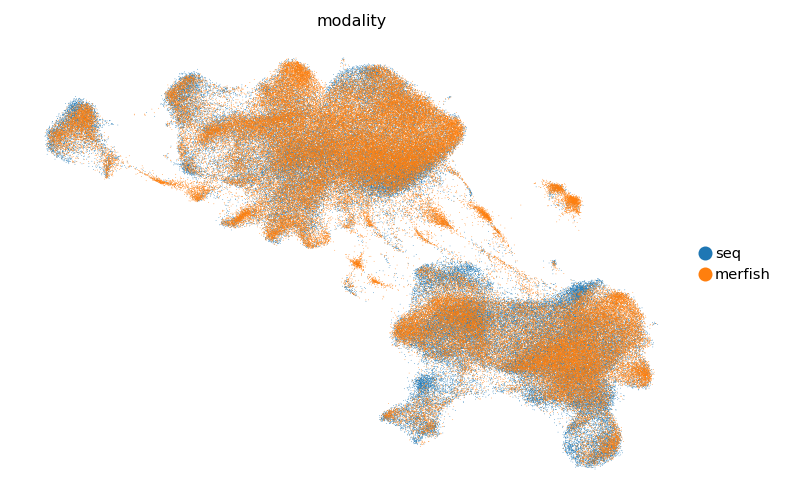

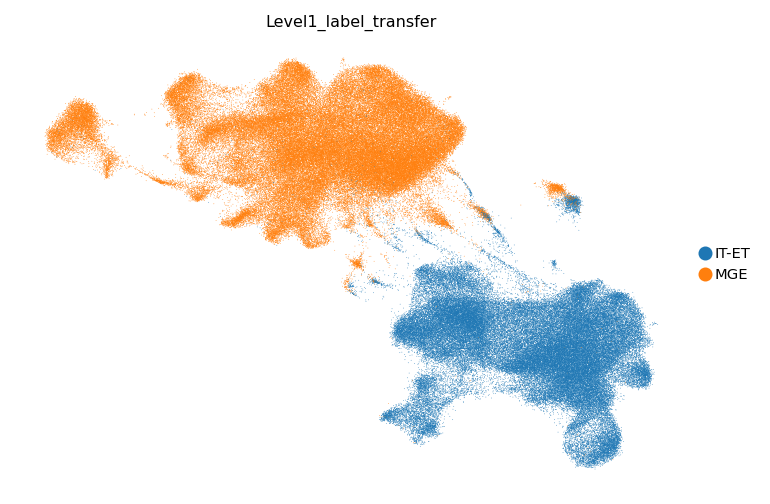

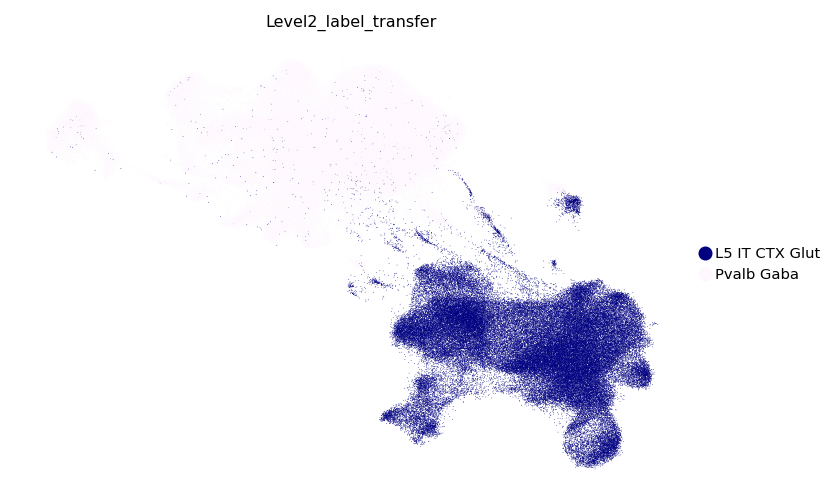

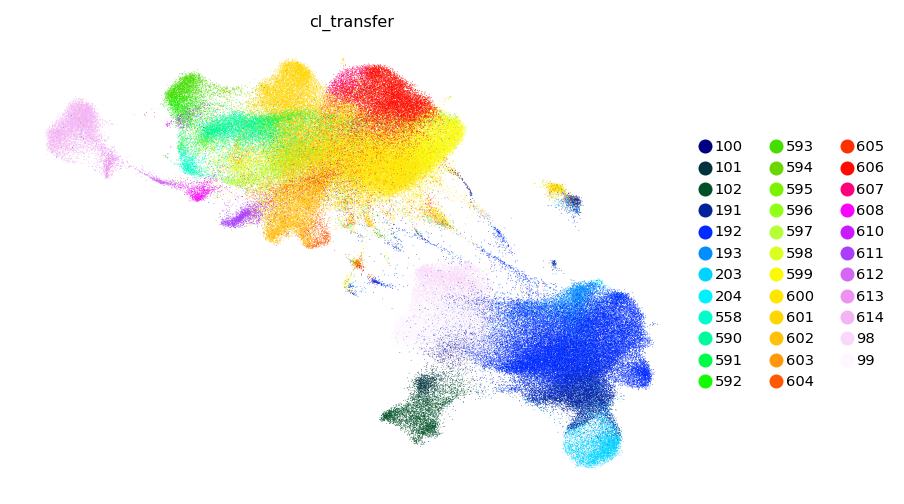

Integrate for p78
Use 1106 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 41467 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 2/2 Level1_label.
Transfered 2/2 Level2_label.
Transfered 21/21 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


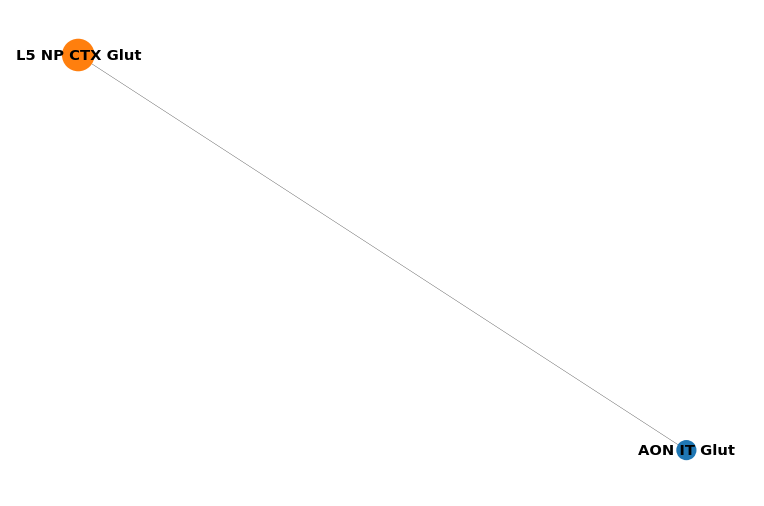

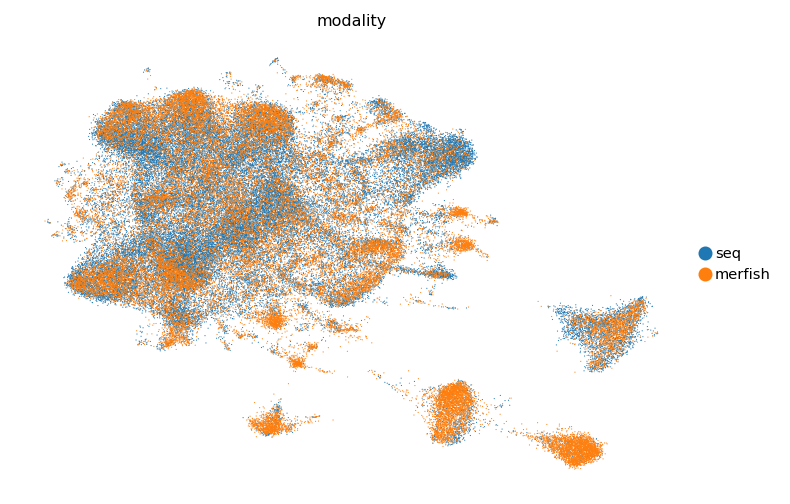

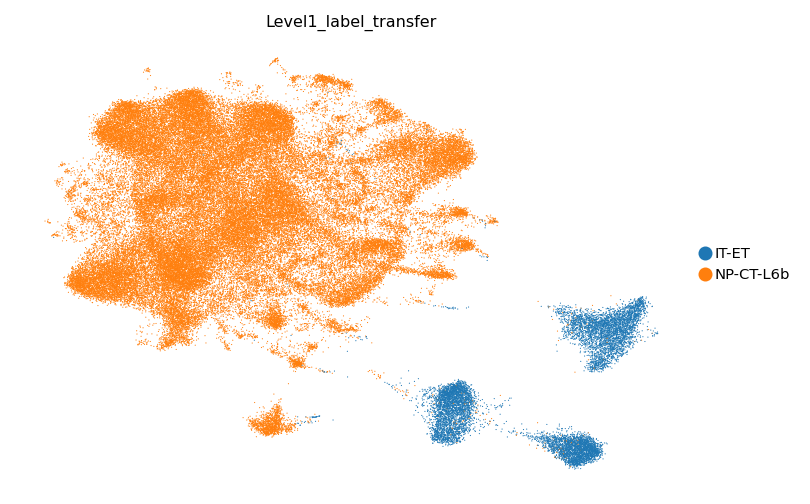

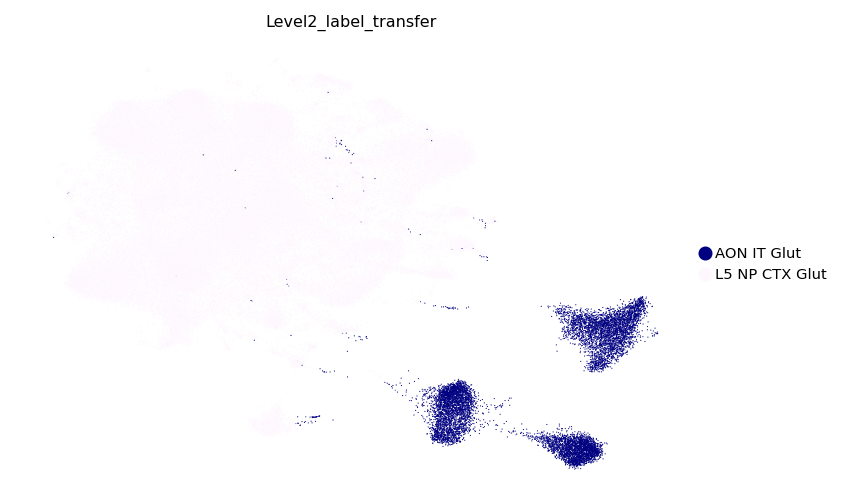

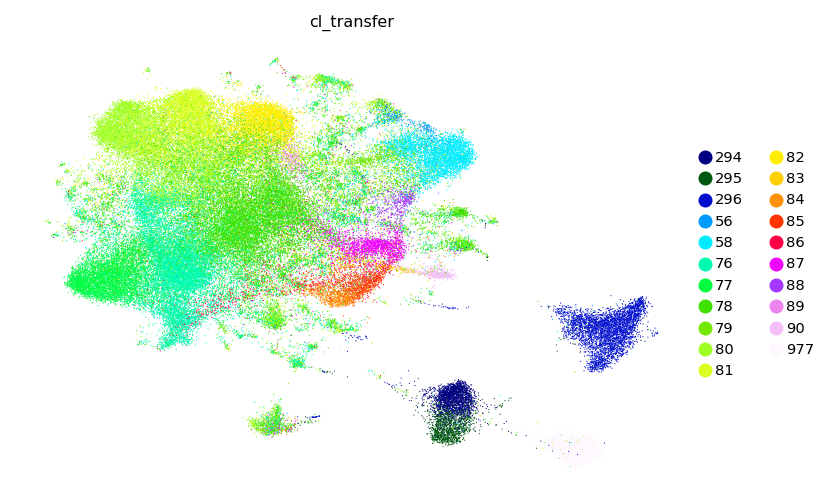

Integrate for p79
Use 1110 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 62701 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 1/1 Level1_label.
Transfered 1/1 Level2_label.
Transfered 32/32 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


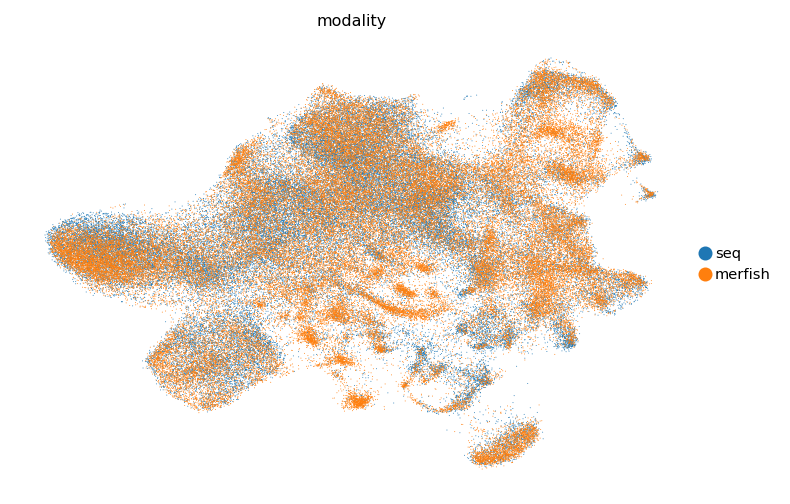

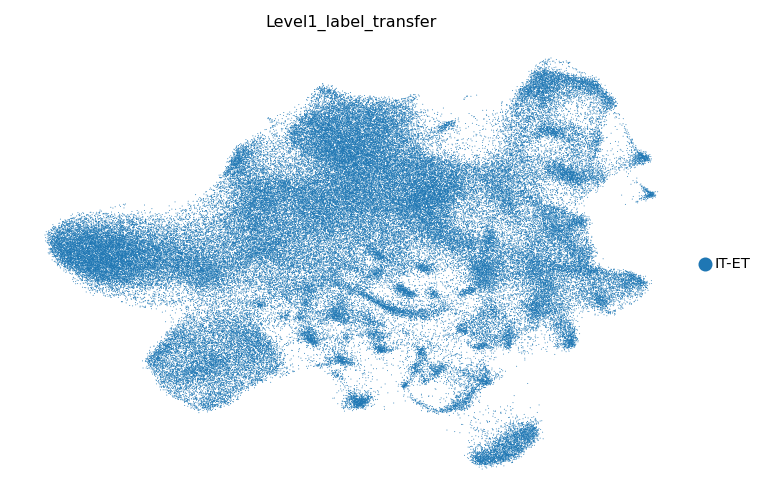

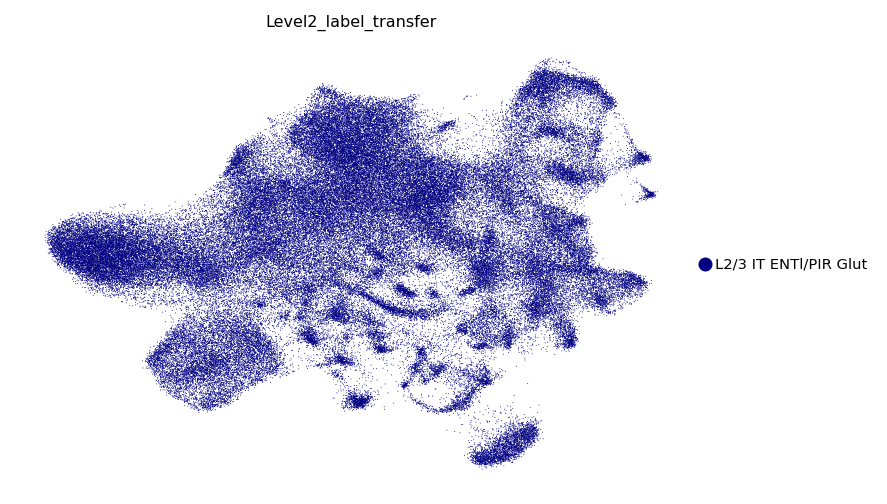

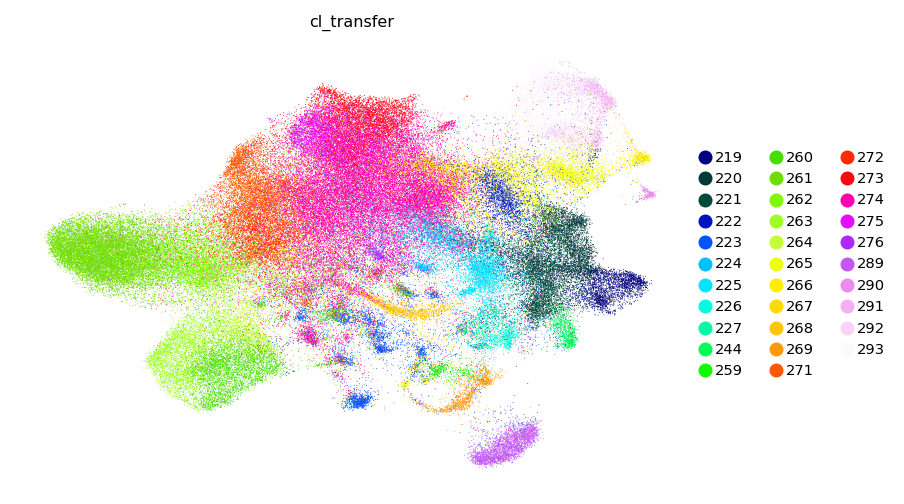

Integrate for p8
Use 1122 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 57862 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 10/10 Level1_label.
Transfered 36/36 Level2_label.
Transfered 303/303 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


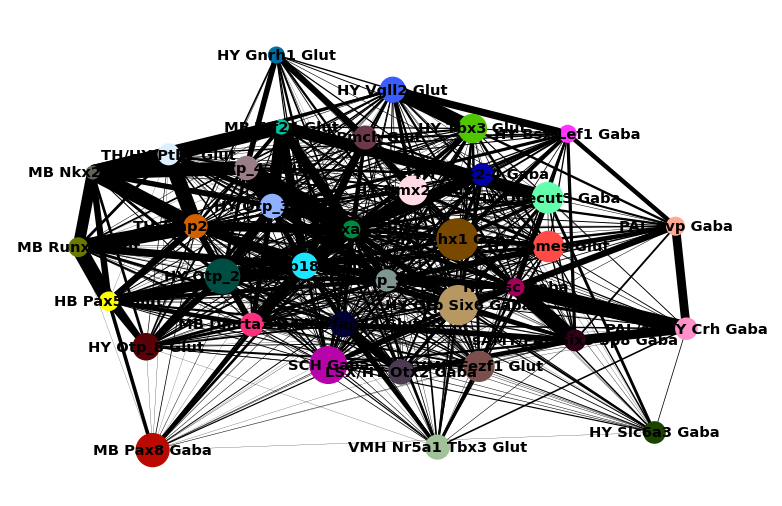

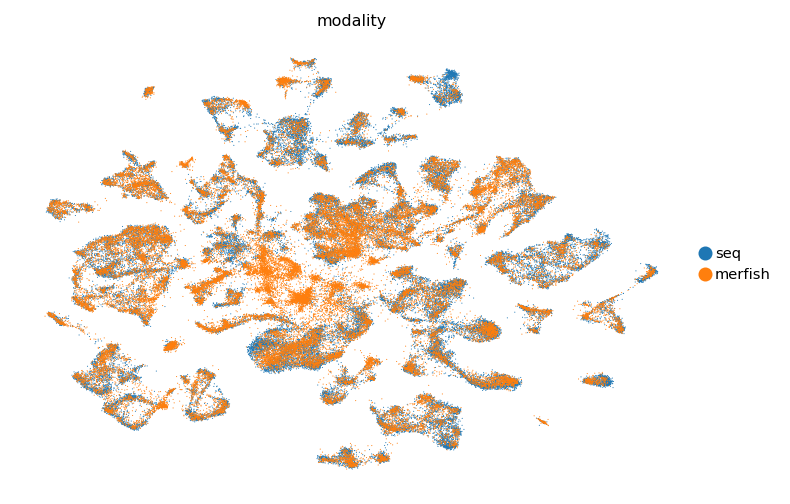

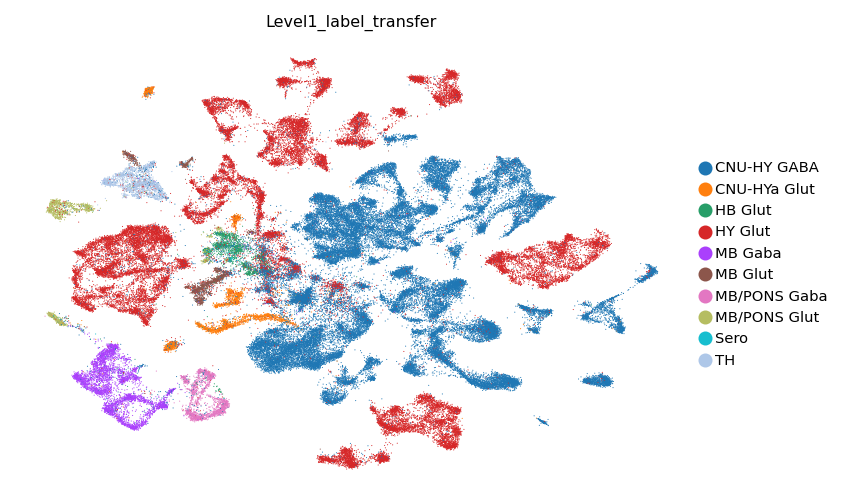

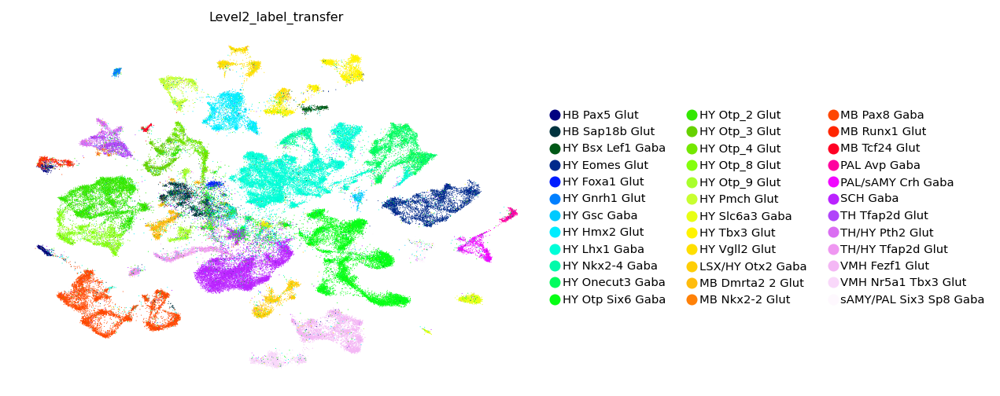

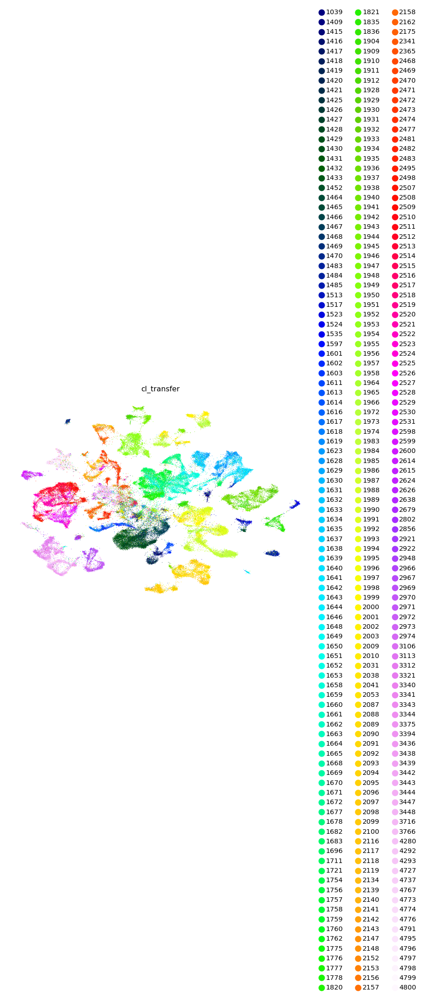

Integrate for p9
Use 1121 highly variable genes for integration.


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Find anchors across datasets
Run CCA
Find Anchors
Score Anchors
Identified 48134 anchors between datasets 0 and 1.
Initialize
Find nearest anchors
Normalize graph
Label transfer
Transfered 10/10 Level1_label.
Transfered 19/19 Level2_label.
Transfered 267/268 cl.
Initialize
Find nearest anchors
Normalize graph
Merge datasets
[[0], [1]]
Initialize
Find nearest anchors


/home/xingjiepan/Softwares/conda/anaconda3/envs/allcools/lib/python3.8/site-packages/ALLCools/integration/seurat_class.py:552: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  corrected = self.transform(data=np.array(corrected),


Normalize graph
Transform data


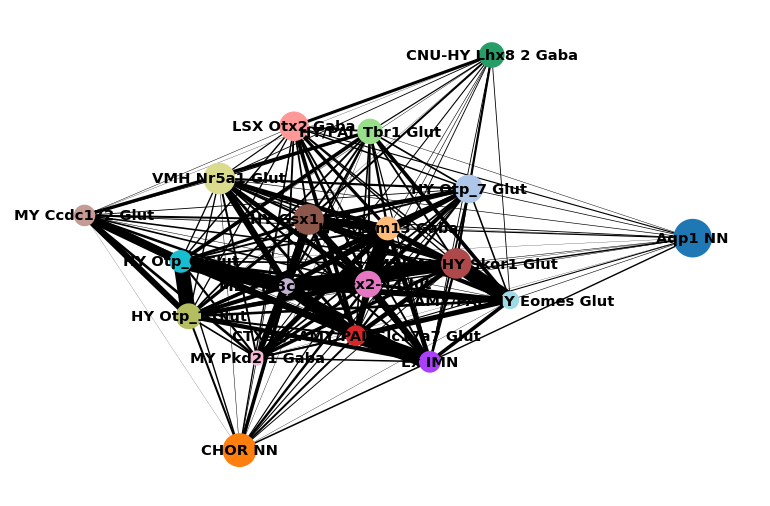

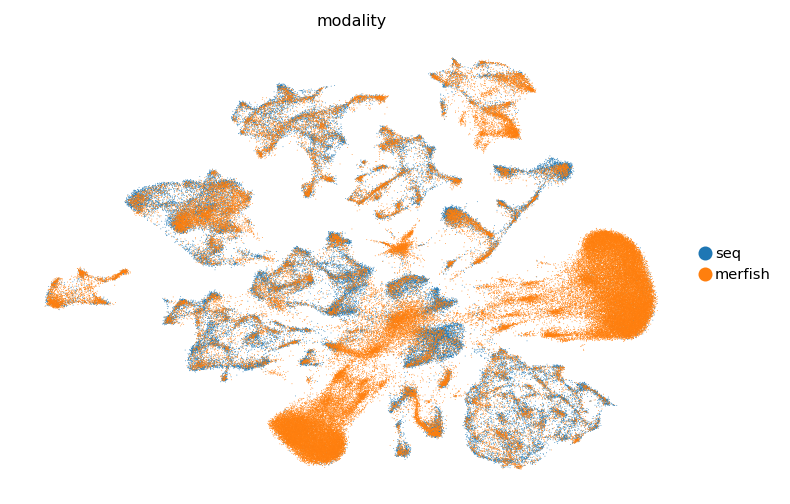

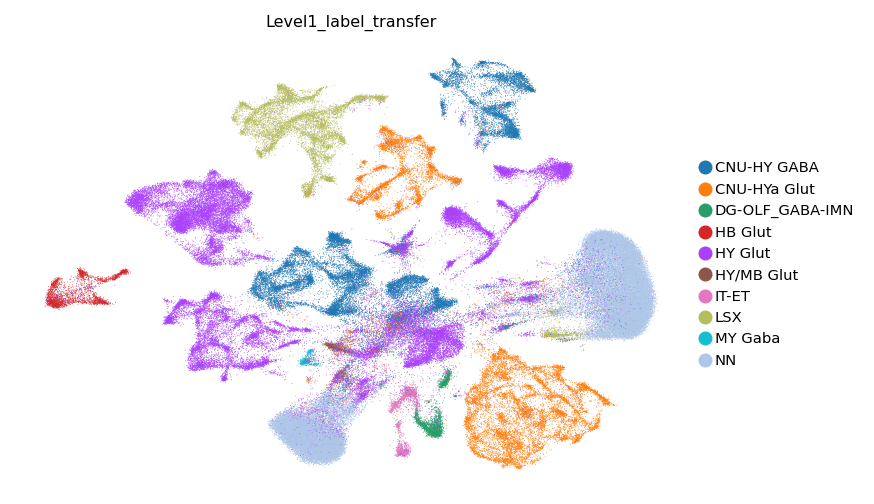

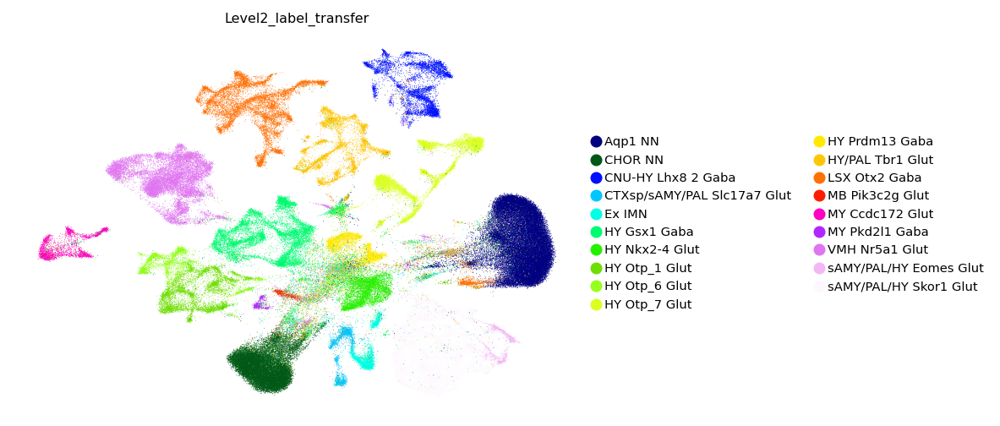

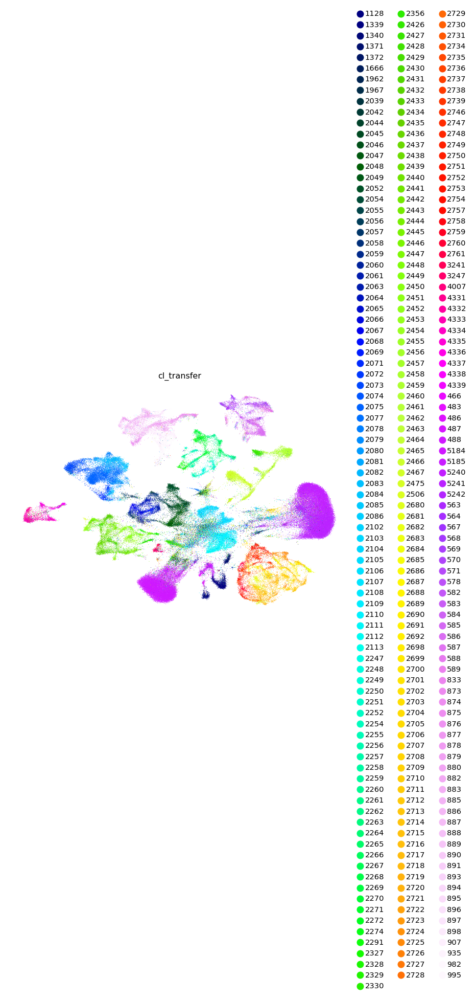

CPU times: user 3d 19h 7min 53s, sys: 9h 35min 13s, total: 4d 4h 43min 7s
Wall time: 6h 29min 7s


In [7]:
%%time
imputation_path = os.path.join(workspace_path, 'gene_expression_imputation')
partition_path = os.path.join(workspace_path, 'partitions')
partitions = sorted(os.listdir(partition_path))

partitions = ['p49', 'p5', 'p54', 'p58', 'p6', 'p64', 'p66', 'p67', 'p69', 'p7', 'p70', 'p71', 'p72', 'p73', 'p74', 
'p75', 'p76', 'p77', 'p78', 'p79', 'p8', 'p9']

for pn in partitions:
    print(f'Integrate for {pn}')
    integration_path = os.path.join(partition_path, pn)
    input_adata_seq_file = os.path.join(integration_path, 'adata_seq.h5ad')
    input_adata_merfish_file = os.path.join(integration_path, 'adata_merfish_integrated.h5ad')
    
    if not (os.path.exists(input_adata_seq_file) and os.path.exists(input_adata_merfish_file)):
        print('Missing input file. Skip the integration.')
        continue
    
    ## Load and preprocess the data
    adata_seq_raw = sc.read_h5ad(input_adata_seq_file)
    adata_seq = adata_seq_raw.copy()
    adata_merfish_raw = sc.read_h5ad(input_adata_merfish_file)
    adata_merfish = adata_merfish_raw.copy()
    
    # Consider the common genes
    common_genes = np.array(adata_seq.var_names.intersection(adata_merfish.var_names))
    adata_seq._inplace_subset_var(common_genes)
    
    # Normalize
    sc.pp.normalize_total(adata_seq, target_sum=1000)
    sc.pp.log1p(adata_seq)
    sc.pp.normalize_total(adata_merfish, target_sum=1000)
    sc.pp.log1p(adata_merfish)
    
    # Select variable genes
    sc.pp.highly_variable_genes(adata_seq)
    hv_genes = list(adata_seq.var.index[adata_seq.var['dispersions'] > 0])
    adata_seq = adata_seq[:, adata_seq.var.index.isin(hv_genes)]
    adata_merfish = adata_merfish[:, adata_merfish.var.index.isin(hv_genes)]
    print(f'Use {len(hv_genes)} highly variable genes for integration.')
    
    # Scale the data
    sc.pp.scale(adata_seq)
    sc.pp.scale(adata_merfish)
    
    # Merge the datasets
    adata_merge = adata_seq.concatenate(adata_merfish,
                                    batch_categories=['seq', 'merfish'],
                                    batch_key='modality',
                                    index_unique=None)
    
    # PCA
    n_pcs = min(100, len(hv_genes))
    sc.tl.pca(adata_merge, svd_solver='arpack', n_comps=n_pcs)
    
    adata_list = [adata_merge[adata_merge.obs['modality'] == 'seq'],
                  adata_merge[adata_merge.obs['modality'] == 'merfish']]
    
    ## Integration
    # Find the integration anchors
    integrator = SeuratIntegration()
    integrator.find_anchor(adata_list,
                       k_local=None,
                       key_local='X_pca',
                       k_anchor=5,
                       key_anchor='X',
                       dim_red='cca',
                       max_cc_cells=100000,
                       k_score=30,
                       k_filter=None, #why?
                       scale1=False,
                       scale2=False,
                       n_components=n_pcs,
                       n_features=200,
                       alignments=[[[0], [1]]])
    
    # Label transfer
    cell_type_cols = ['Level1_label', 'Level2_label', 'cl']
    transfer_results = integrator.label_transfer(
        ref=[0],
        qry=[1],
        categorical_key=cell_type_cols,
        key_dist='X_pca',
        kweight=30,
        npc=n_pcs
    )
    integrator.save_transfer_results_to_adata(adata_merge, transfer_results)
    
    # Assign the transfered labels and the confidence
    for cell_type_col in cell_type_cols:
        adata_merfish_raw.obs[cell_type_col + '_transfer'] = transfer_results[cell_type_col].idxmax(axis=1
                                                                                           ).astype('category')
        adata_merfish_raw.obs[cell_type_col + '_confidence'] = transfer_results[cell_type_col].max(axis=1)
        
        n_transfered = len(np.unique(adata_merfish_raw.obs[cell_type_col + '_transfer']))
        n_total = len(np.unique(adata_merge.obs[cell_type_col + '_transfer']))
        print(f'Transfered {n_transfered}/{n_total} {cell_type_col}.')
    
    # Save the label transfer results
    adata_merfish_raw.write(os.path.join(integration_path, 'adata_merfish_label_transfer.h5ad'))     
    
    # Impute gene expression
    X_imputed = impute_gene_expression(integrator, adata_list, adata_seq_raw.X, 
                                       ref=0, qry=1, npc=n_pcs, chunk_size=5000)
    adata_imputed = anndata.AnnData(X=X_imputed, obs=adata_merfish_raw.obs.copy(), 
                                var=adata_seq_raw.var.copy(), dtype=np.float32)
    
    # Save the imputation results

    for sn in np.unique(adata_imputed.obs['Level2_label_transfer']):
        adata_subset = adata_imputed[adata_imputed.obs['Level2_label_transfer'] == sn]
        output_file = os.path.join(imputation_path, sn.replace('/', '-').replace(' ', '_') + '.h5ad')
        adata_subset.write(output_file)
        
    ## Co-embedding
    # Correct the PCs using the integration anchors
    corrected = integrator.integrate(key_correct='X_pca',
                                 row_normalize=True,
                                 n_components=n_pcs,
                                 k_weight=100,
                                 sd=1,
                                 alignments=[[[0], [1]]])

    adata_merge.obsm['X_pca_integrate'] = np.concatenate(corrected)
    
    # Calculate KNN using the integrated PCs
    sc.pp.neighbors(adata_merge, use_rep='X_pca_integrate')
    
    if len(np.unique(adata_merge.obs['Level2_label_transfer'])) > 1:
        # Generate the PAGA plot for the initial arrangement of the UMAP
        sc.tl.paga(adata_merge, groups='Level2_label_transfer')
        sc.pl.paga(adata_merge, save='_tmp.png', cmap='gist_ncar')
        shutil.move('figures/paga_tmp.png', os.path.join(integration_path, 'integration_paga_round2.png'))
    
        sc.tl.umap(adata_merge, init_pos='paga', min_dist=0.5)
    else:
        sc.tl.umap(adata_merge, min_dist=0.5)
        
    # Save the umap
    sc.pl.umap(adata_merge, color='modality', save='_tmp.png')
    shutil.move('figures/umap_tmp.png', os.path.join(integration_path, 'integration_umap_modality.png'))
    sc.pl.umap(adata_merge, color='Level1_label_transfer', save='_tmp.png')
    shutil.move('figures/umap_tmp.png', os.path.join(integration_path, 'integration_umap_Level1_label.png'))
    sc.pl.umap(adata_merge, color='Level2_label_transfer', save='_tmp.png', palette='gist_ncar')
    shutil.move('figures/umap_tmp.png', os.path.join(integration_path, 'integration_umap_Level2_label.png'))
    sc.pl.umap(adata_merge, color='cl_transfer', save='_tmp.png', palette='gist_ncar')
    shutil.move('figures/umap_tmp.png', os.path.join(integration_path, 'integration_umap_cl.png'))
    
    
    # Save the merged adata
    adata_merge.write(os.path.join(integration_path, 'adata_merged_round2.h5ad'))

# Combine the integration results

In [27]:
# Combine the label transfer results
adatas = []
for pn in partitions:
    adata_file = os.path.join(partition_path, pn, 'adata_merfish_label_transfer.h5ad')
    adatas.append(sc.read_h5ad(adata_file))
    
adata = anndata.concat(adatas)
adata.write(os.path.join(workspace_path, 'adata_merfish_label_transfer.h5ad'))

In [28]:
print('N_Level1_label =', len(np.unique(adata.obs['Level1_label_transfer'])))
print('N_Level2_label =', len(np.unique(adata.obs['Level2_label_transfer'])))
print('N_clusters =', len(np.unique(adata.obs['cl_transfer'])))

N_Level1_label = 27
N_Level2_label = 289
N_clusters = 5282


Text(0.5, 1.0, 'partition_confidence')

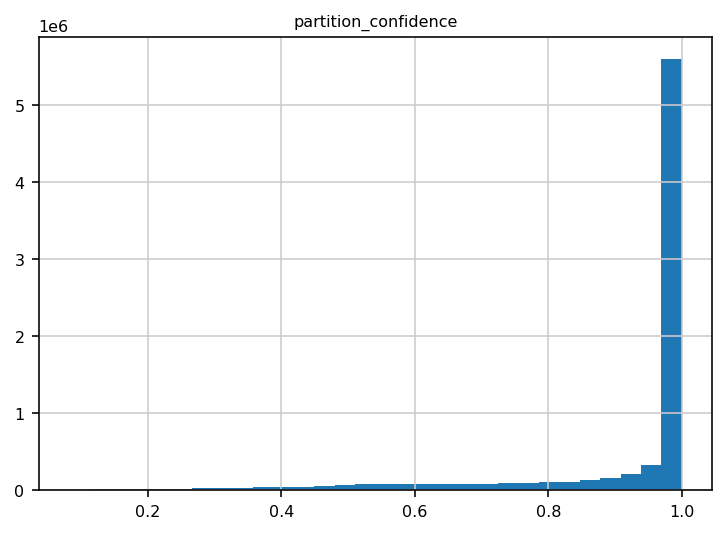

In [29]:
plt.hist(adata.obs['integration_partition_confidence'], bins=30)
plt.title('partition_confidence')

Text(0.5, 1.0, 'Level1_label_confidence')

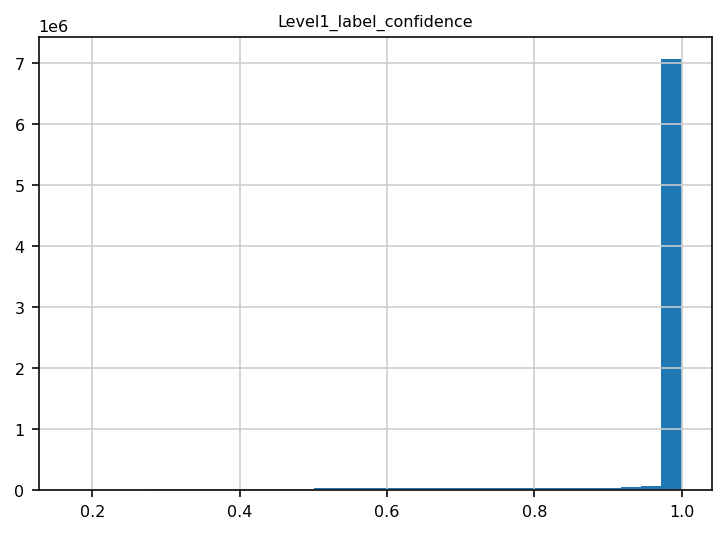

In [30]:
plt.hist(adata.obs['Level1_label_confidence'], bins=30)
plt.title('Level1_label_confidence')

Text(0.5, 1.0, 'Level2_label_confidence')

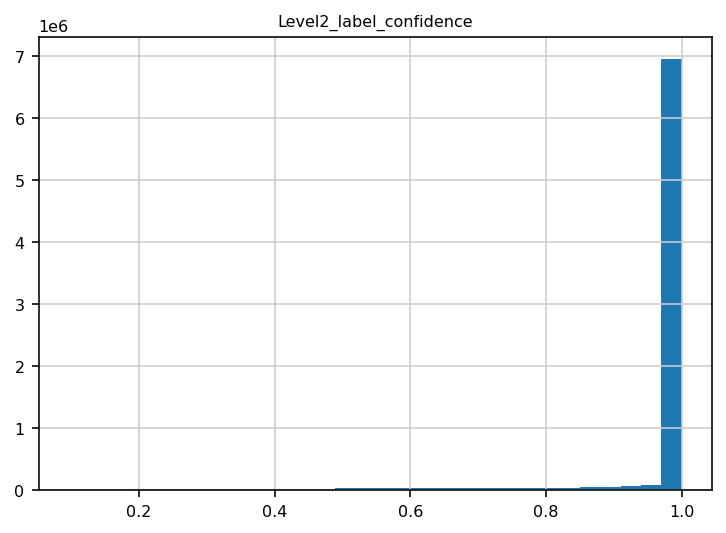

In [31]:
plt.hist(adata.obs['Level2_label_confidence'], bins=30)
plt.title('Level2_label_confidence')

Text(0.5, 1.0, 'cl_confidence')

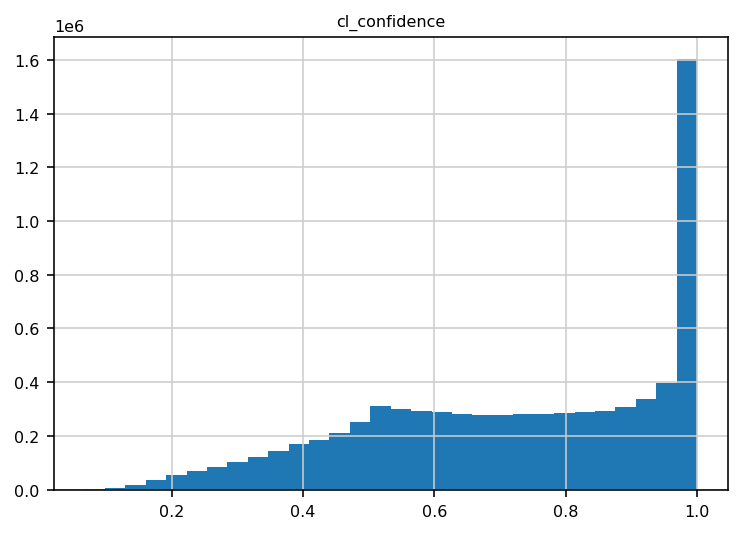

In [32]:
plt.hist(adata.obs['cl_confidence'], bins=30)
plt.title('cl_confidence')

In [33]:
adata

AnnData object with n_obs × n_vars = 7550626 × 1122
    obs: 'integration_partition_transfer', 'integration_partition_confidence', 'Level1_label_transfer', 'Level1_label_confidence', 'Level2_label_transfer', 'Level2_label_confidence', 'cl_transfer', 'cl_confidence'